# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [8]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(input=labels, num_classes=n_classes)
    #### END CODE HERE ####

In [9]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [10]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [11]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [12]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [13]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [22]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [23]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [24]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.318226830363274, discriminator loss: 0.27617446340993046


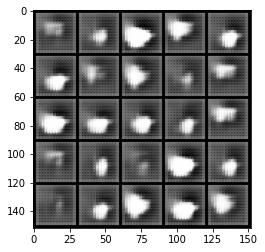

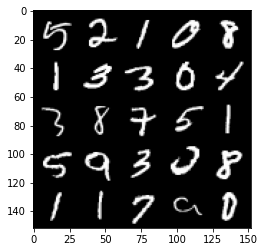

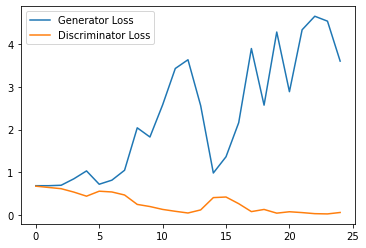

Step 1000: Generator loss: 3.6637153520584107, discriminator loss: 0.07958957677707076


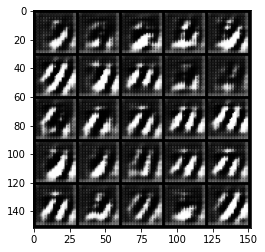

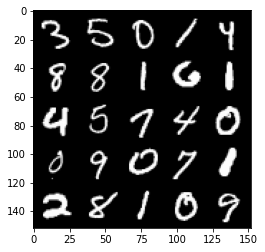

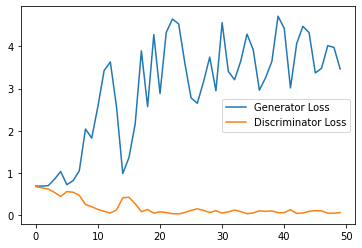

Step 1500: Generator loss: 3.1487002940177917, discriminator loss: 0.14543988900631666


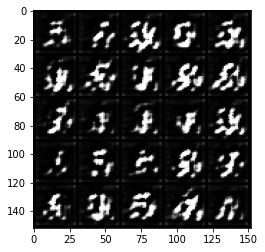

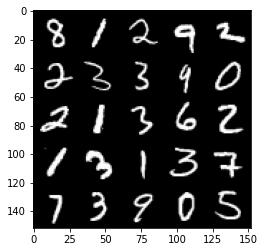

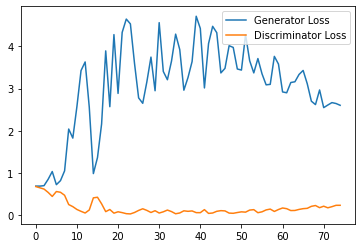

Step 2000: Generator loss: 2.334984134197235, discriminator loss: 0.2789080031812191


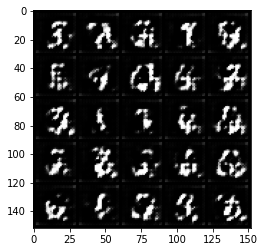

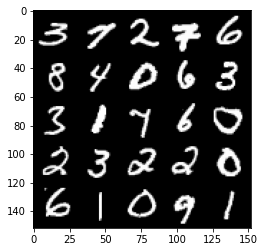

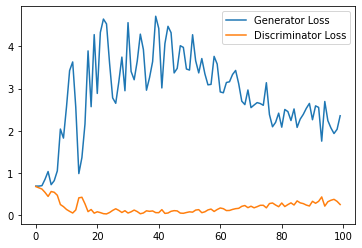

Step 2500: Generator loss: 1.920889778137207, discriminator loss: 0.37014754039049147


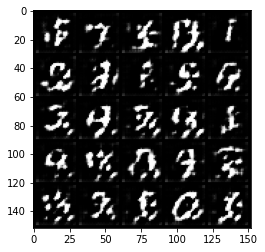

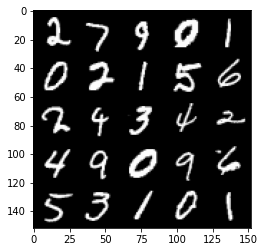

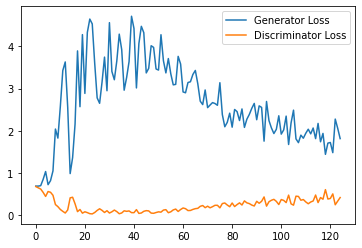

Step 3000: Generator loss: 1.6468340075016021, discriminator loss: 0.3894365520477295


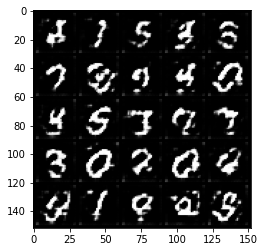

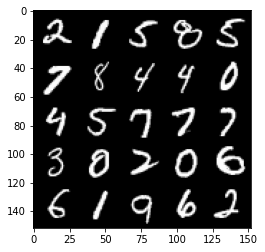

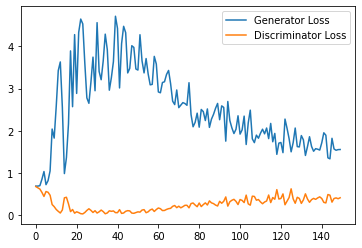

Step 3500: Generator loss: 1.7668639743328094, discriminator loss: 0.39514565700292587


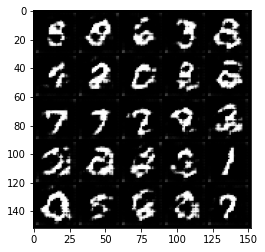

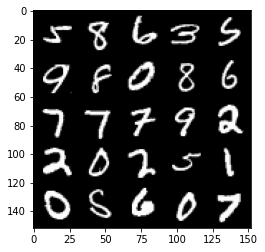

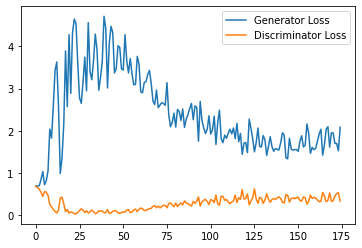

Step 4000: Generator loss: 1.8089263517856597, discriminator loss: 0.40249950571358206


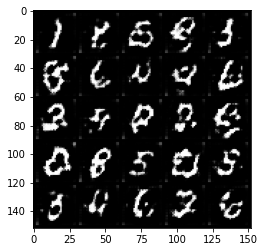

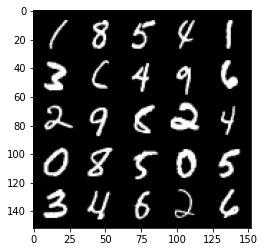

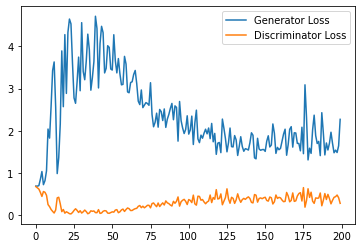

Step 4500: Generator loss: 1.6428782430887223, discriminator loss: 0.40572999849915503


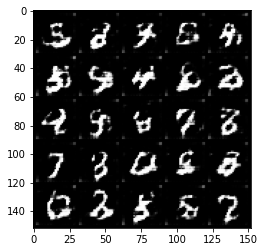

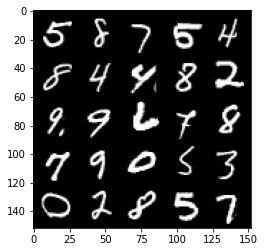

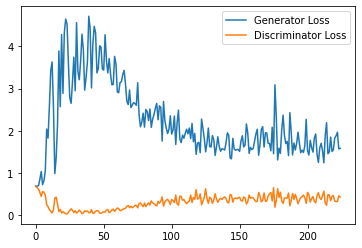

Step 5000: Generator loss: 1.6220410521030426, discriminator loss: 0.4462106088399887


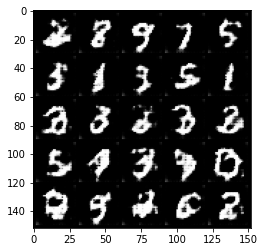

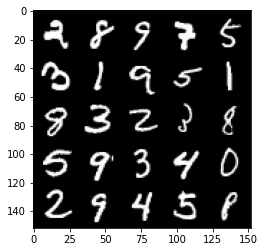

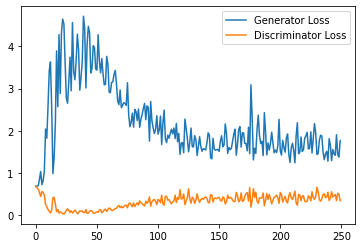

Step 5500: Generator loss: 1.5501972126960755, discriminator loss: 0.4430992965400219


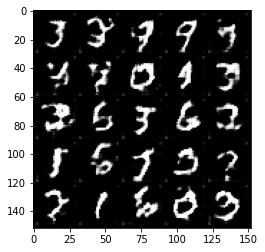

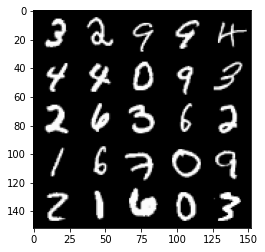

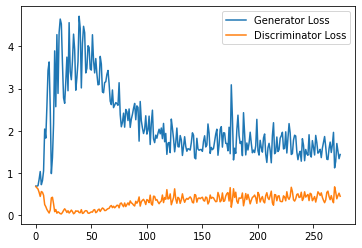

Step 6000: Generator loss: 1.544246416091919, discriminator loss: 0.447873979896307


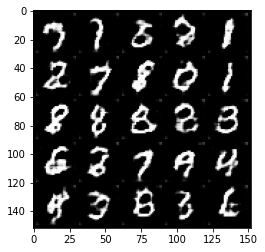

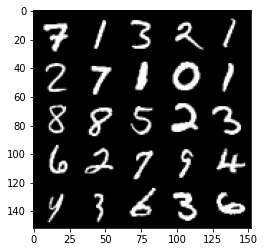

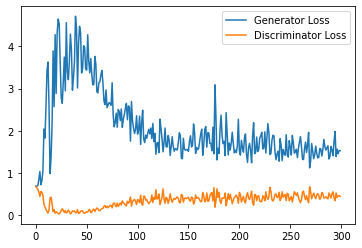

Step 6500: Generator loss: 1.4082239464521409, discriminator loss: 0.4665670126080513


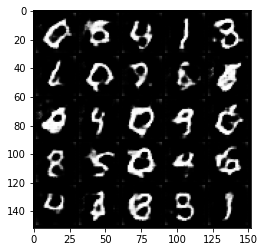

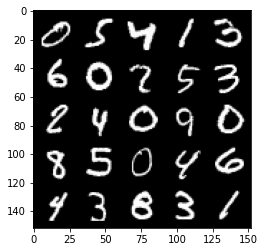

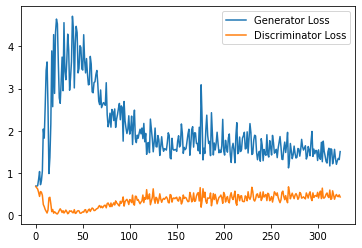

Step 7000: Generator loss: 1.4850263296365738, discriminator loss: 0.4810356470346451


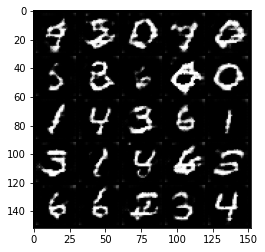

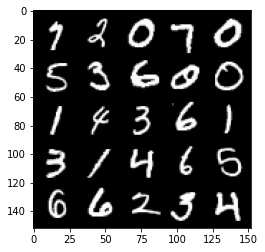

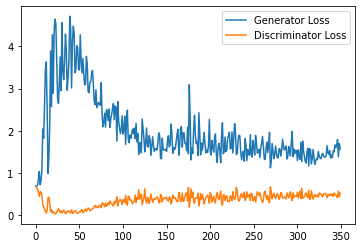

Step 7500: Generator loss: 1.3756508795022964, discriminator loss: 0.4961374849677086


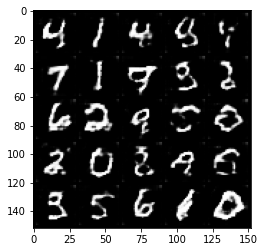

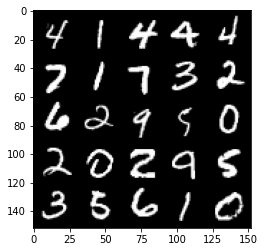

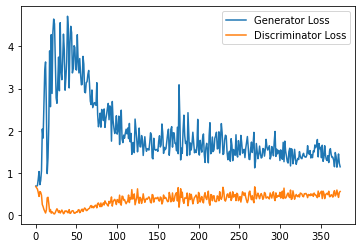

Step 8000: Generator loss: 1.2480524710416794, discriminator loss: 0.5085427982807159


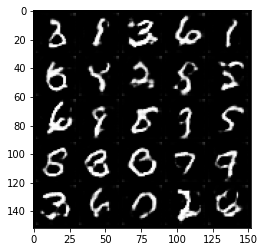

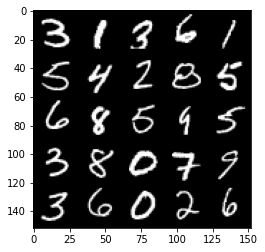

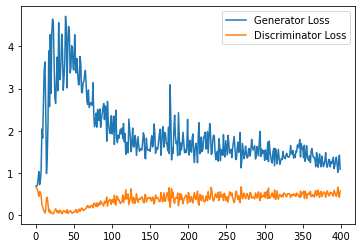

Step 8500: Generator loss: 1.2432679116725922, discriminator loss: 0.5389421468377114


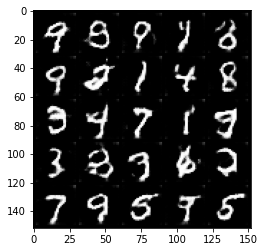

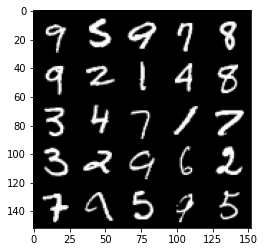

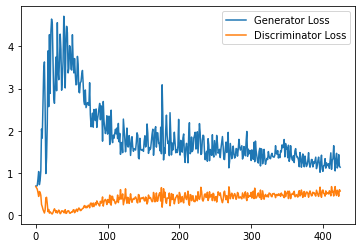

Step 9000: Generator loss: 1.2627778309583664, discriminator loss: 0.5378325045704841


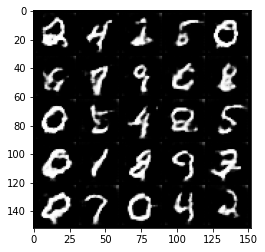

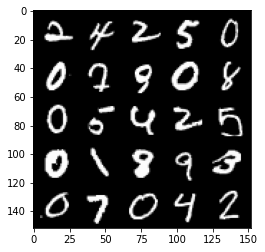

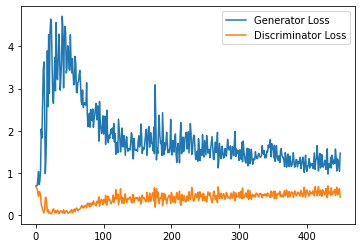

Step 9500: Generator loss: 1.1557630583047867, discriminator loss: 0.5607647049427033


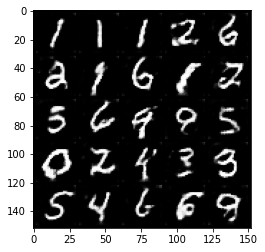

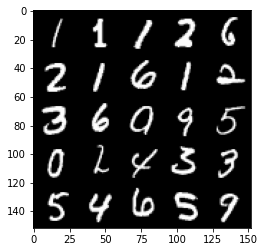

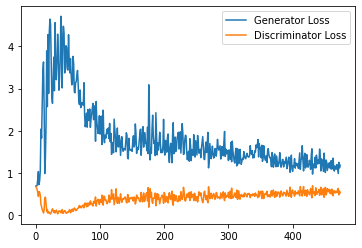

Step 10000: Generator loss: 1.1225151417255401, discriminator loss: 0.5496596391797066


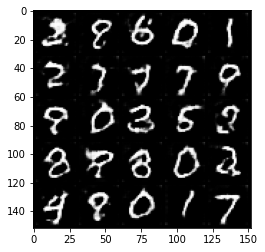

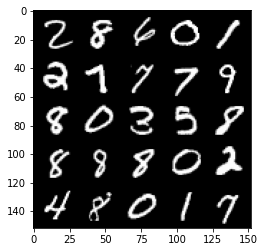

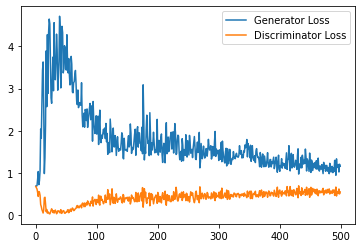

Step 10500: Generator loss: 1.180211017370224, discriminator loss: 0.5560428937673568


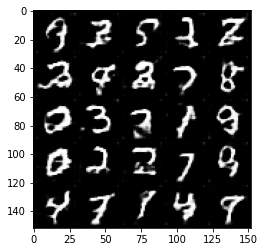

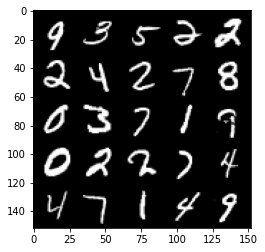

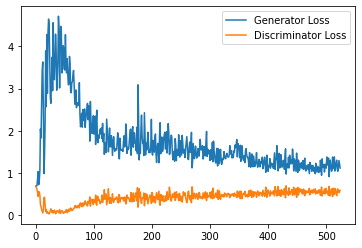

Step 11000: Generator loss: 1.1228499361276627, discriminator loss: 0.5629295852184296


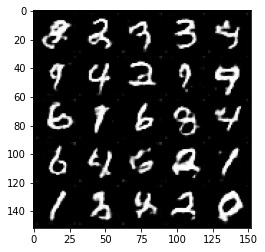

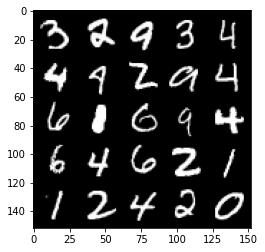

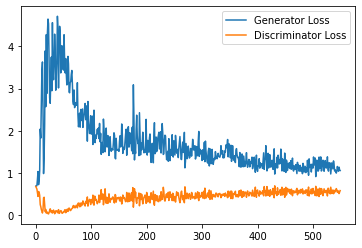

Step 11500: Generator loss: 1.1326143388748169, discriminator loss: 0.5714458661675453


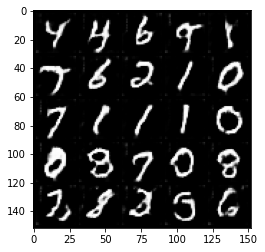

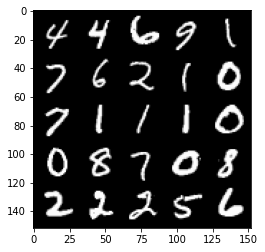

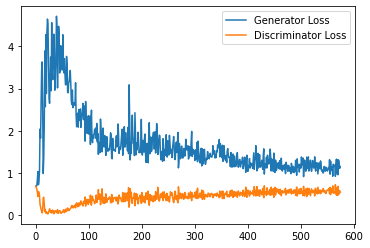

Step 12000: Generator loss: 1.098898282647133, discriminator loss: 0.572535672545433


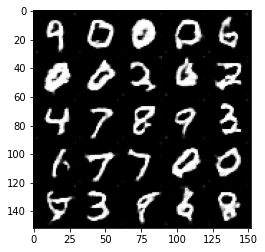

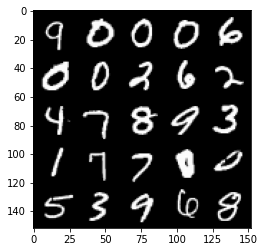

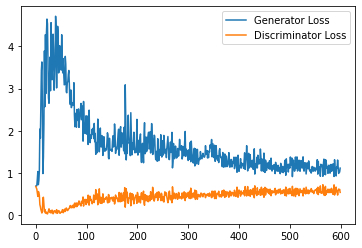

Step 12500: Generator loss: 1.0535532711744309, discriminator loss: 0.5712480376958847


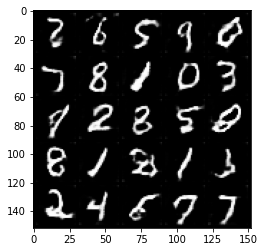

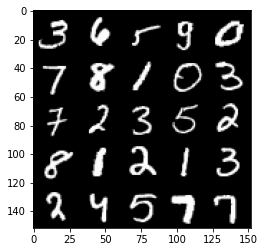

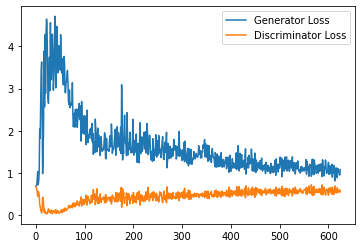

Step 13000: Generator loss: 1.0807903646230697, discriminator loss: 0.5813626363277435


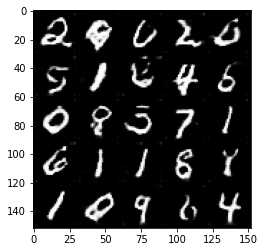

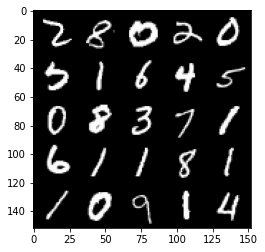

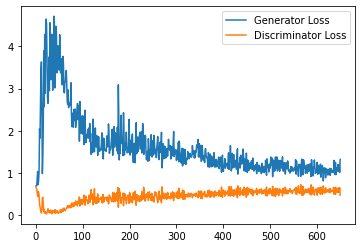

Step 13500: Generator loss: 1.0825245807170867, discriminator loss: 0.5850079355835914


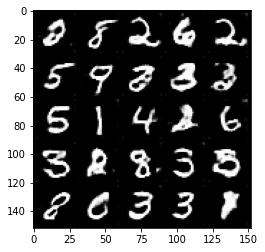

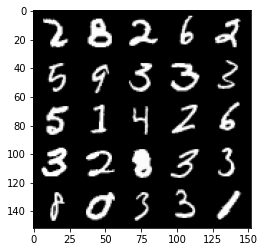

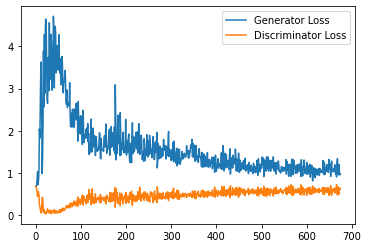

Step 14000: Generator loss: 1.0657929790019989, discriminator loss: 0.5803130791187286


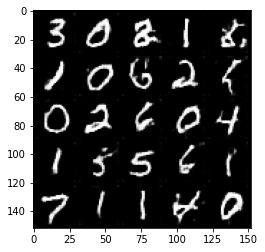

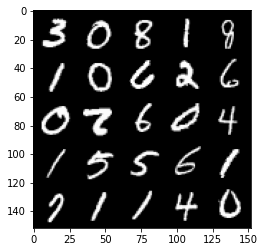

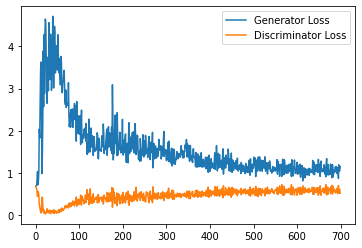

Step 14500: Generator loss: 1.0674547889232635, discriminator loss: 0.5836619358062745


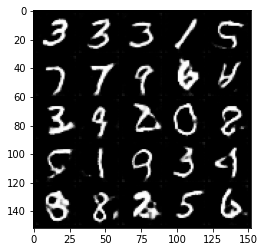

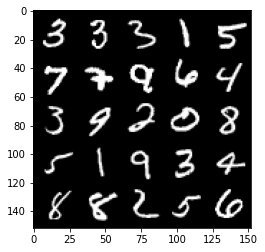

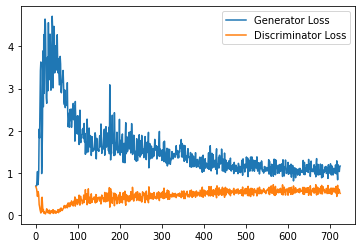

Step 15000: Generator loss: 1.064009313583374, discriminator loss: 0.5888679162859917


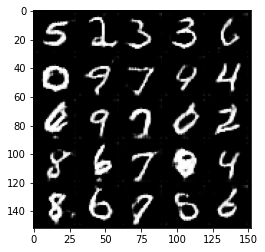

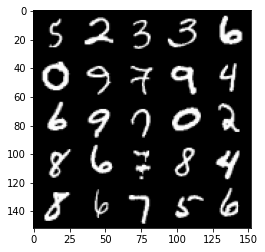

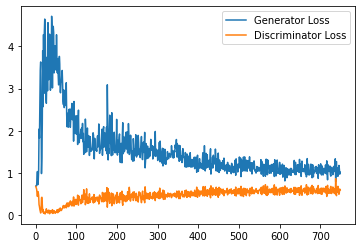

Step 15500: Generator loss: 1.0349400585889816, discriminator loss: 0.580096065402031


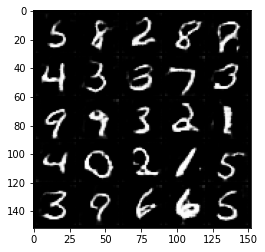

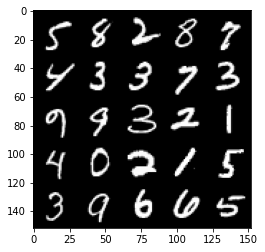

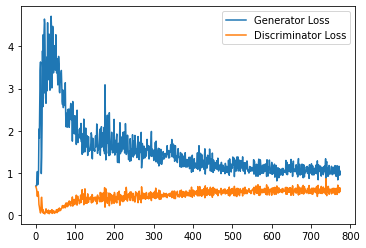

Step 16000: Generator loss: 1.0388866386413573, discriminator loss: 0.5808998311161995


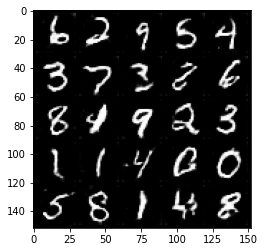

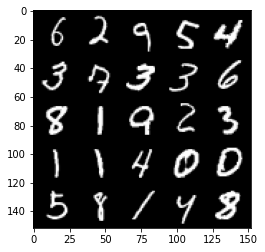

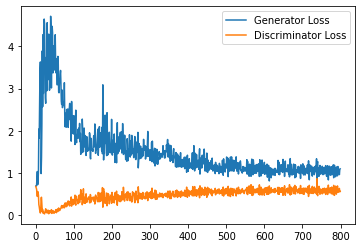

Step 16500: Generator loss: 1.0516675860881806, discriminator loss: 0.5844607262015342


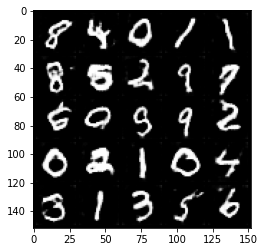

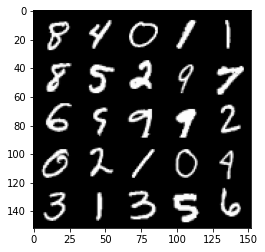

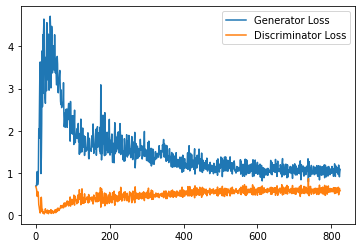

Step 17000: Generator loss: 1.0518522686958314, discriminator loss: 0.574579373717308


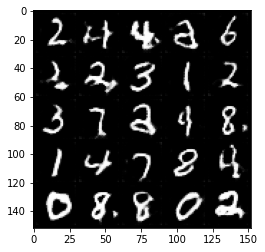

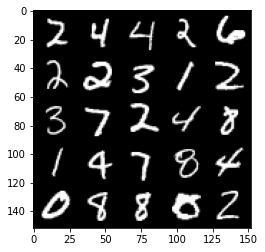

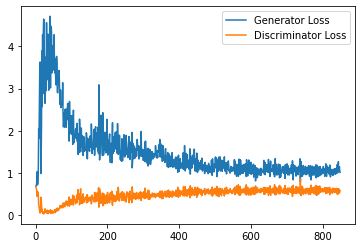

Step 17500: Generator loss: 1.0476517345905303, discriminator loss: 0.5824228879213333


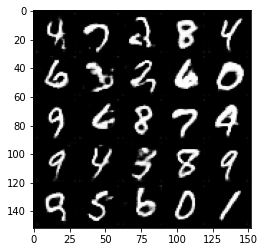

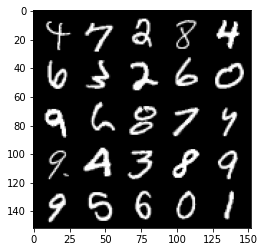

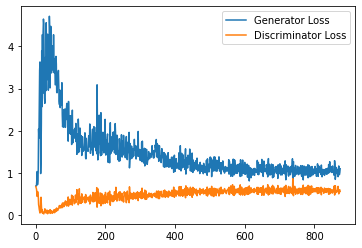

Step 18000: Generator loss: 1.0600375196933747, discriminator loss: 0.5794545463919639


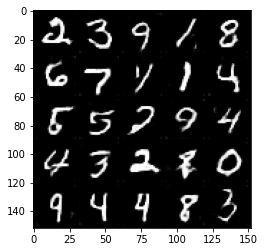

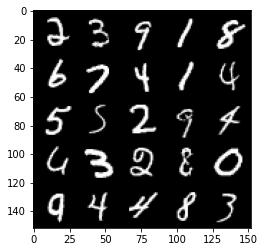

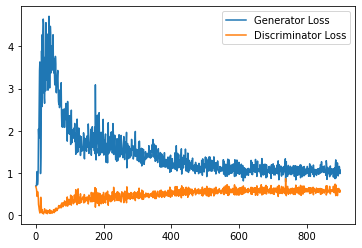

Step 18500: Generator loss: 1.002880205988884, discriminator loss: 0.5825105718374253


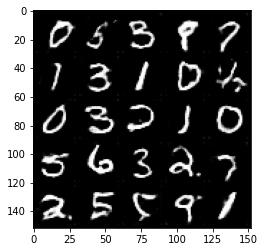

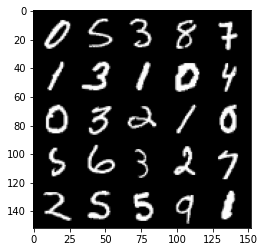

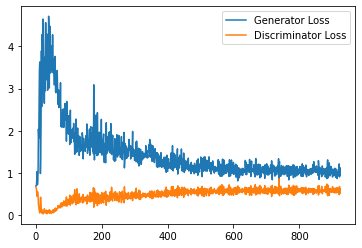

Step 19000: Generator loss: 1.0369482721090317, discriminator loss: 0.5860483457446098


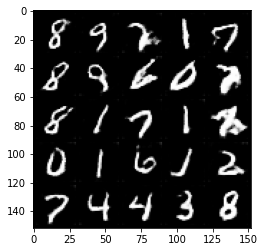

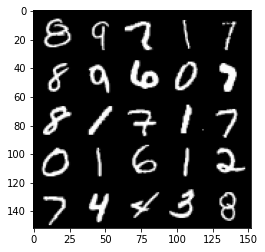

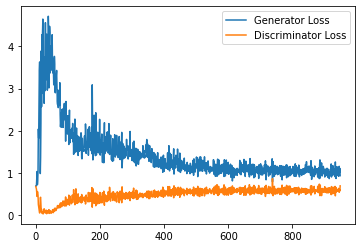

Step 19500: Generator loss: 1.0444307678937912, discriminator loss: 0.5821404257416725


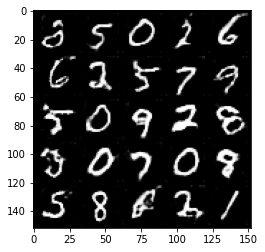

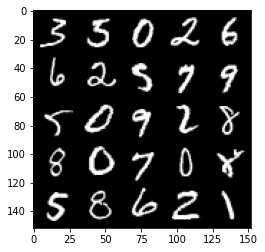

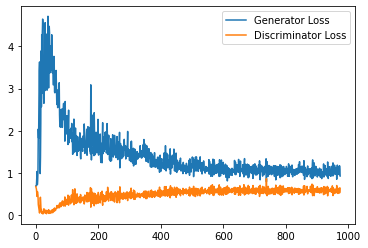

Step 20000: Generator loss: 1.0250534222126007, discriminator loss: 0.5871002226471901


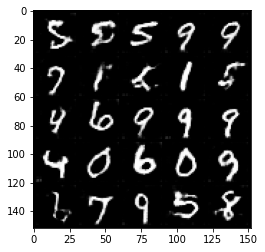

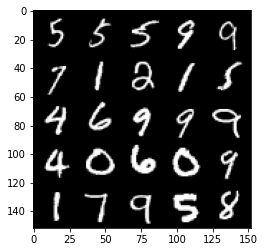

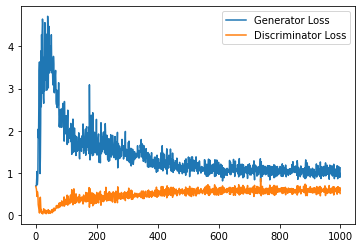

Step 20500: Generator loss: 1.0275907075405122, discriminator loss: 0.5878730147480965


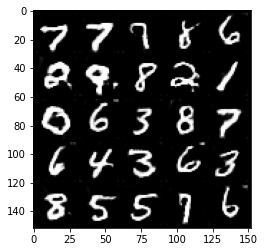

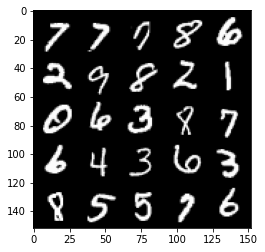

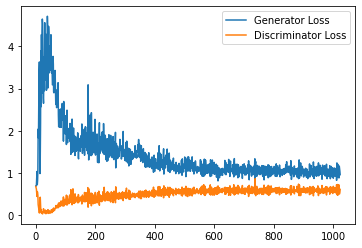

Step 21000: Generator loss: 1.0038280417919159, discriminator loss: 0.5851552309989929


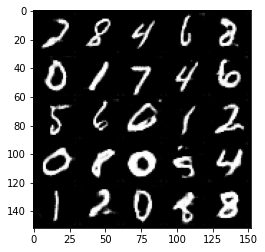

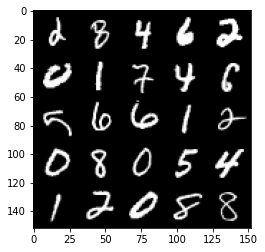

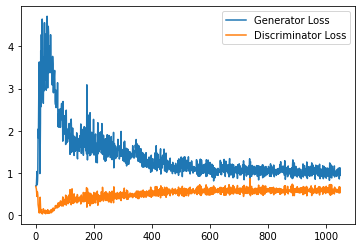

Step 21500: Generator loss: 1.01566772711277, discriminator loss: 0.5794479711651802


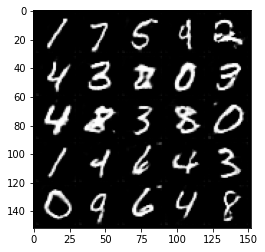

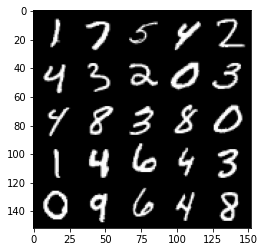

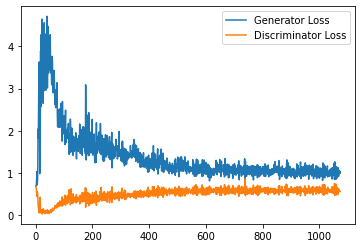

Step 22000: Generator loss: 0.9855863676071167, discriminator loss: 0.5910752894878387


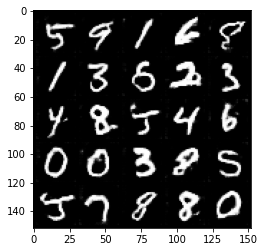

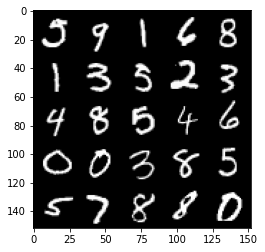

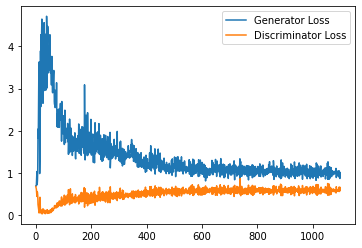

Step 22500: Generator loss: 1.0073339527845382, discriminator loss: 0.586979429602623


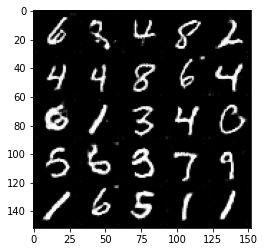

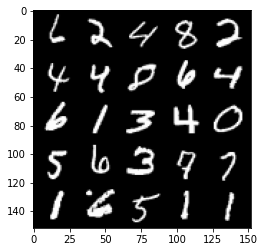

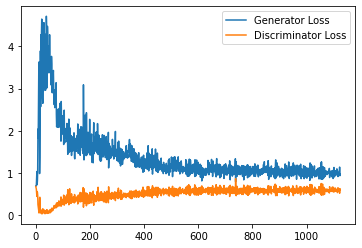

Step 23000: Generator loss: 1.0609442851543427, discriminator loss: 0.5869375529289246


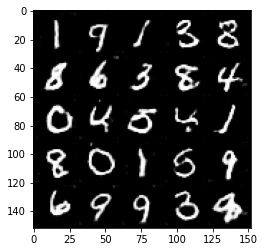

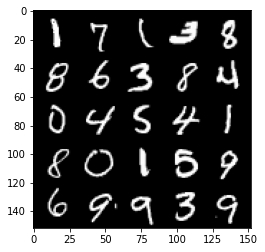

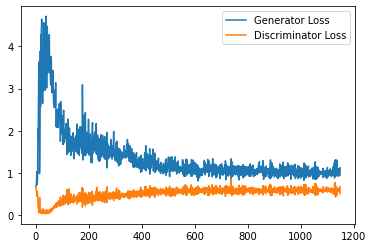

Step 23500: Generator loss: 1.0178407691717148, discriminator loss: 0.5868832279443741


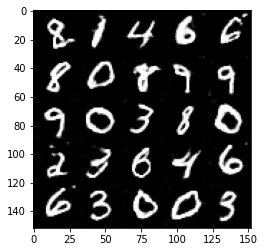

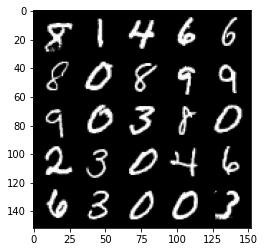

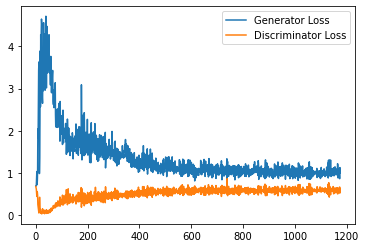

Step 24000: Generator loss: 0.9914223923683166, discriminator loss: 0.5895143485069275


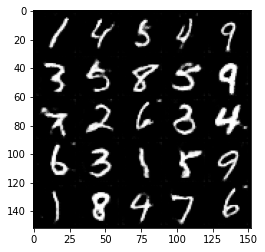

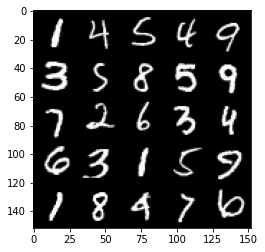

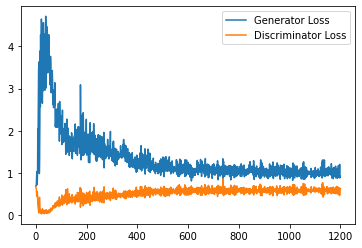

Step 24500: Generator loss: 1.019779878258705, discriminator loss: 0.5799805866479874


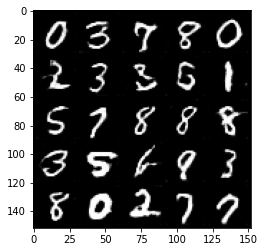

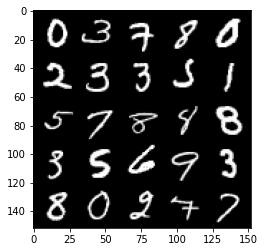

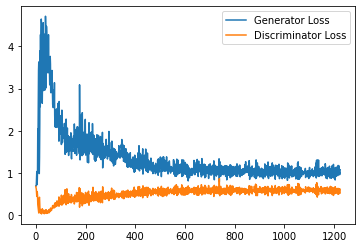

Step 25000: Generator loss: 0.9966072441339493, discriminator loss: 0.5886685995459556


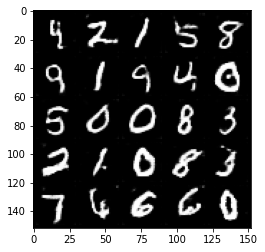

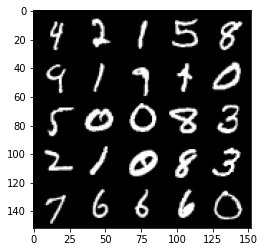

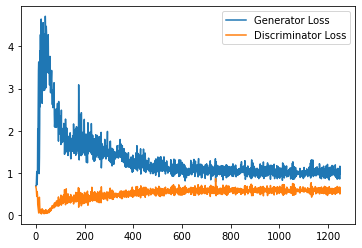

Step 25500: Generator loss: 1.00236396753788, discriminator loss: 0.585958550632


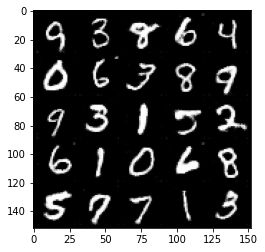

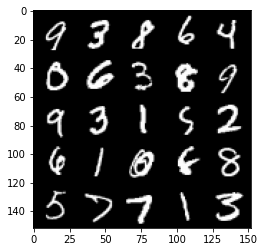

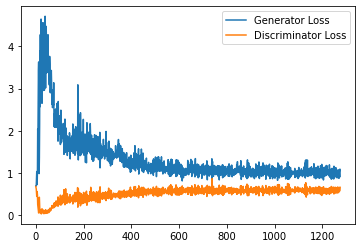

Step 26000: Generator loss: 1.020992549419403, discriminator loss: 0.5850289962887764


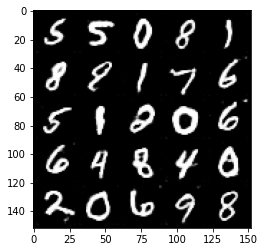

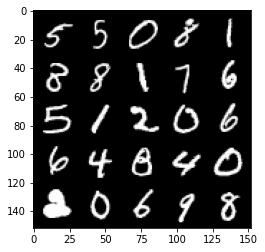

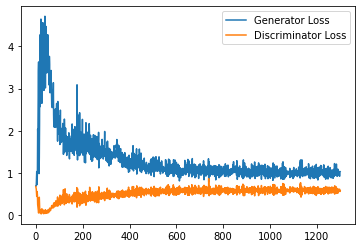

Step 26500: Generator loss: 0.9880320624113083, discriminator loss: 0.5902640665769577


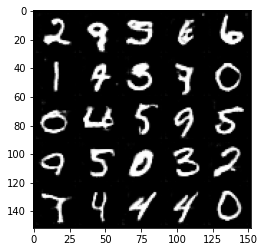

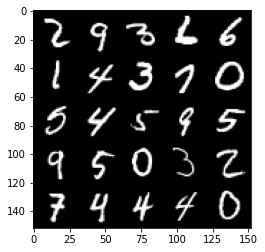

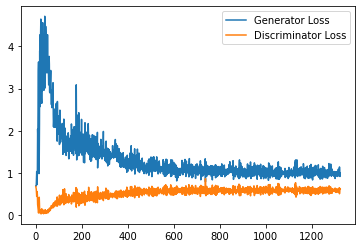

Step 27000: Generator loss: 1.0287928416728973, discriminator loss: 0.5910398551225662


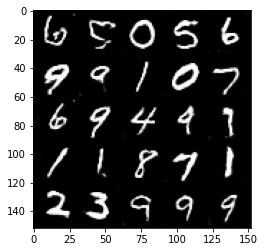

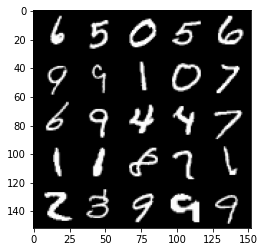

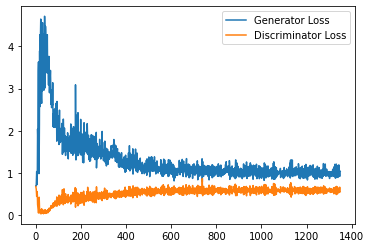

Step 27500: Generator loss: 0.9946194965839386, discriminator loss: 0.5890586853623391


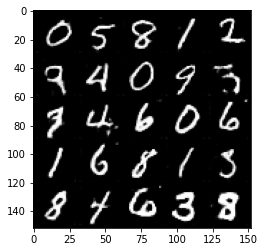

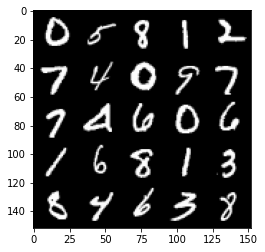

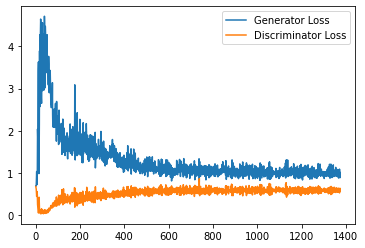

Step 28000: Generator loss: 1.0177775679826737, discriminator loss: 0.5856830276846886


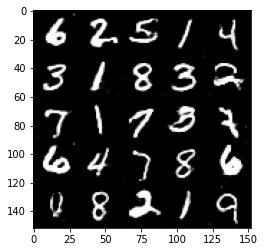

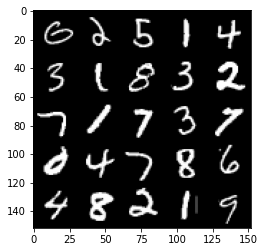

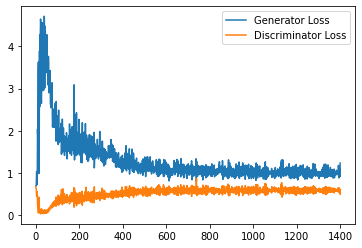

Step 28500: Generator loss: 1.0111910940408706, discriminator loss: 0.5949121413230896


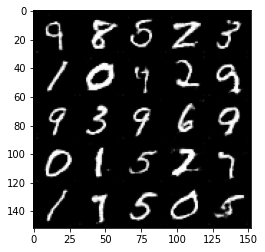

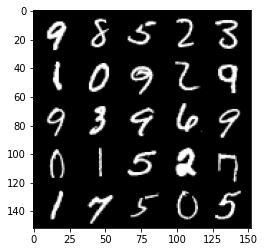

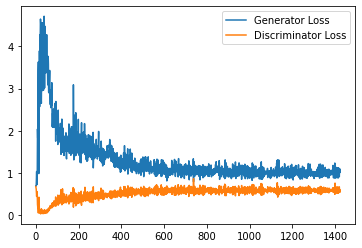

Step 29000: Generator loss: 1.0119459766149521, discriminator loss: 0.5933341826200486


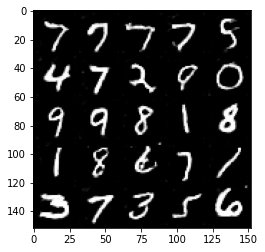

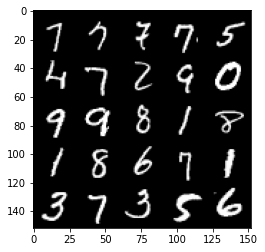

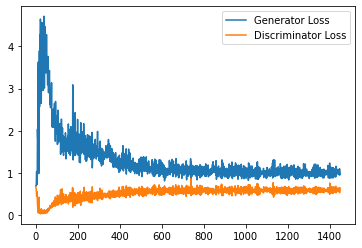

Step 29500: Generator loss: 1.0112424768209458, discriminator loss: 0.5930595426559448


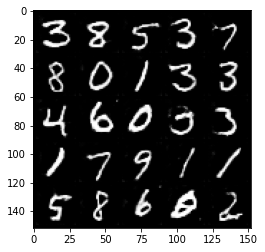

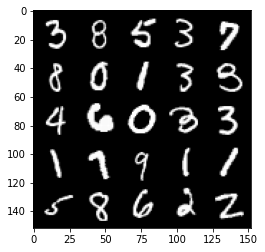

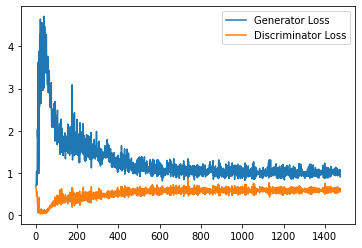

Step 30000: Generator loss: 0.9915188294649124, discriminator loss: 0.5905259194374084


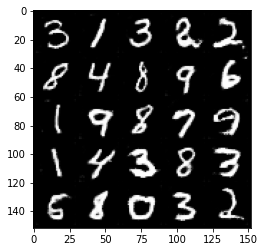

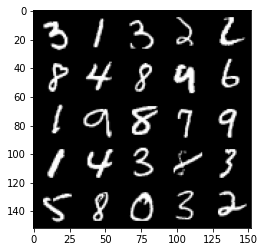

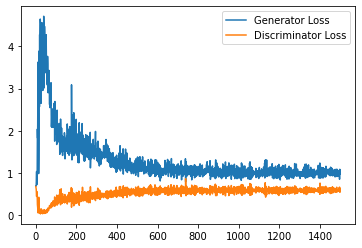

Step 30500: Generator loss: 0.9937924292087555, discriminator loss: 0.5964728202223778


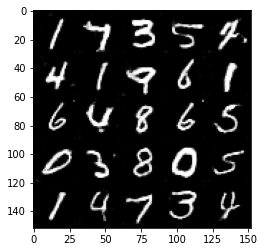

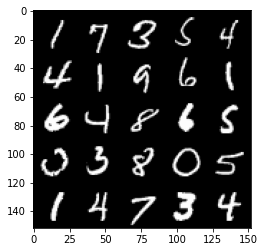

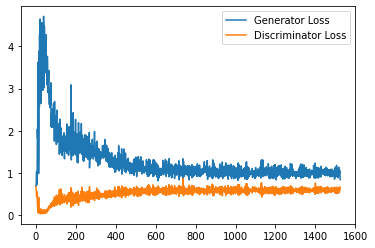

Step 31000: Generator loss: 0.9951688680648804, discriminator loss: 0.5914450232386589


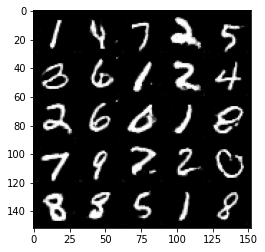

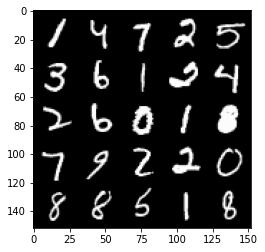

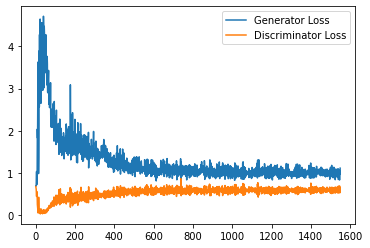

Step 31500: Generator loss: 1.005457330226898, discriminator loss: 0.5969267416596412


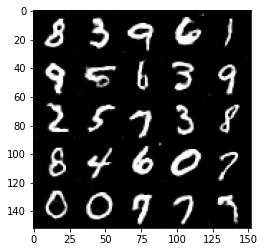

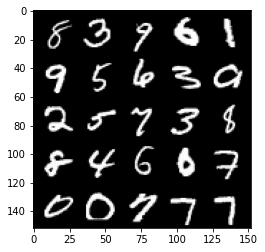

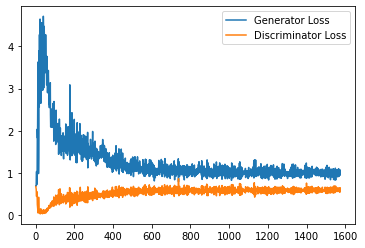

Step 32000: Generator loss: 1.0056064096689223, discriminator loss: 0.5997445519566535


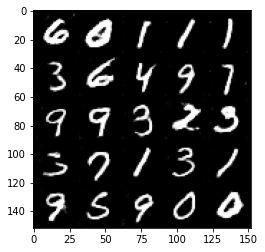

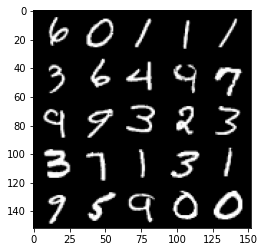

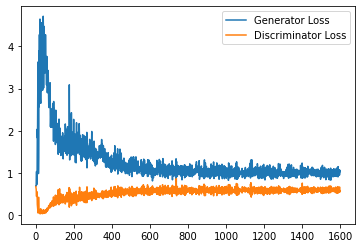

Step 32500: Generator loss: 0.9778002887964249, discriminator loss: 0.5977552480101586


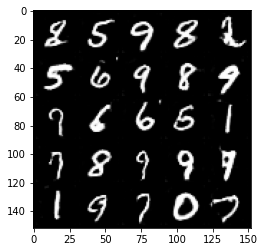

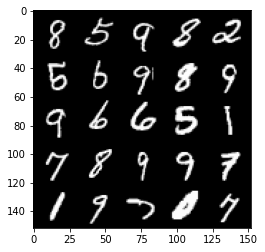

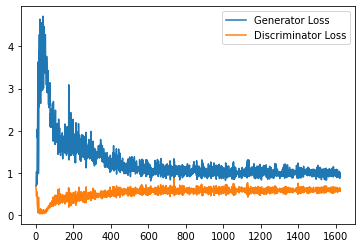

Step 33000: Generator loss: 0.9864592019319535, discriminator loss: 0.5959324158430099


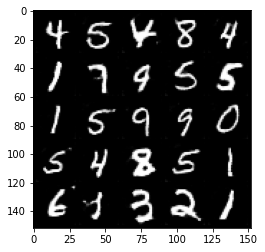

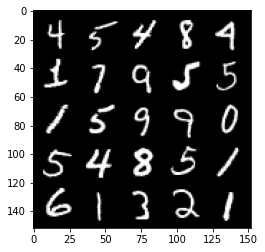

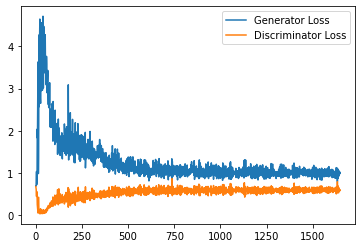

Step 33500: Generator loss: 0.9816505048274994, discriminator loss: 0.6075361625552177


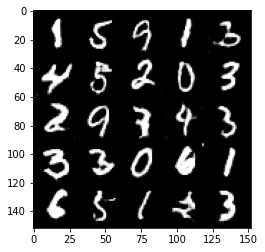

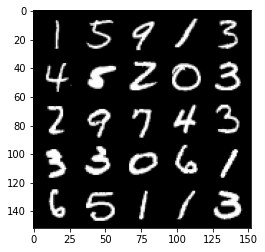

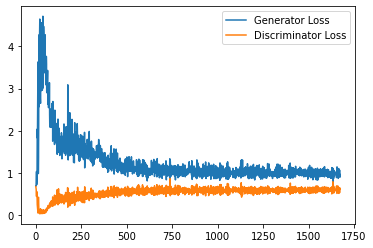

Step 34000: Generator loss: 0.9902512294054031, discriminator loss: 0.5953686038851738


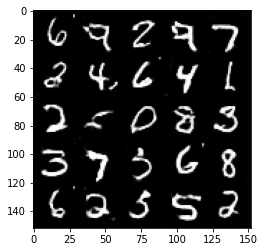

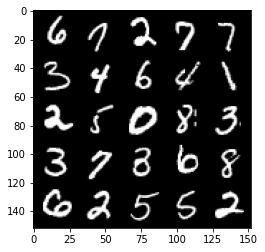

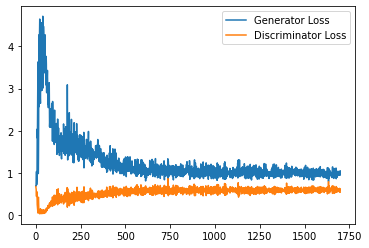

Step 34500: Generator loss: 0.97022987139225, discriminator loss: 0.6016269757151603


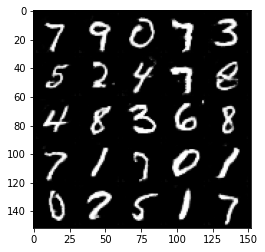

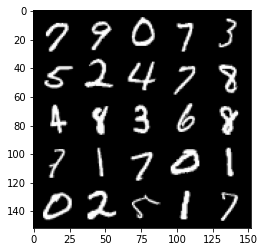

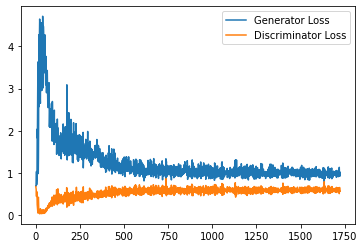

Step 35000: Generator loss: 0.9818417426347733, discriminator loss: 0.6010725092291832


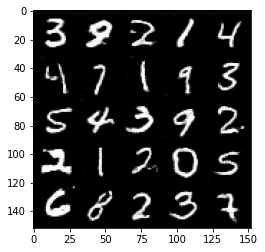

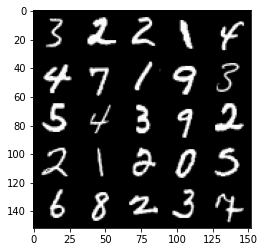

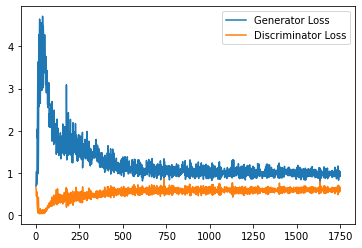

Step 35500: Generator loss: 1.0022250277996063, discriminator loss: 0.602508207976818


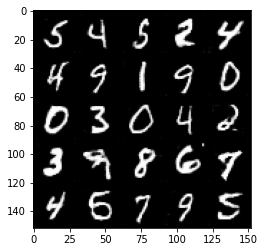

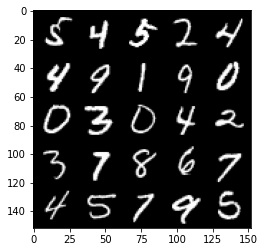

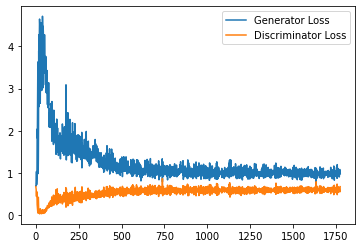

Step 36000: Generator loss: 0.9811289792060852, discriminator loss: 0.6088536031842232


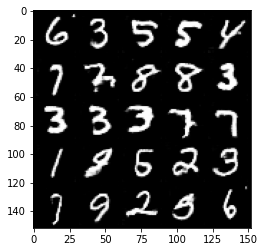

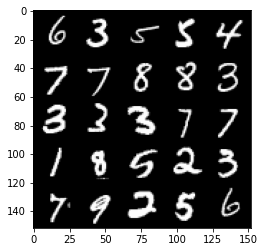

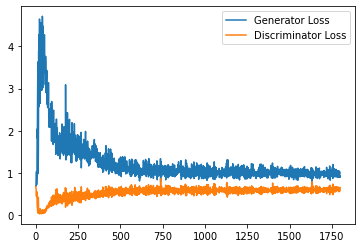

Step 36500: Generator loss: 0.9930173175334931, discriminator loss: 0.6055624945759773


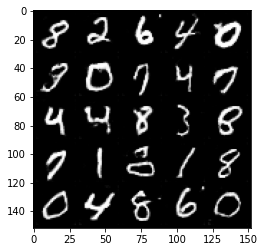

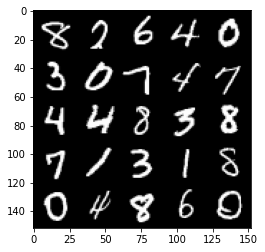

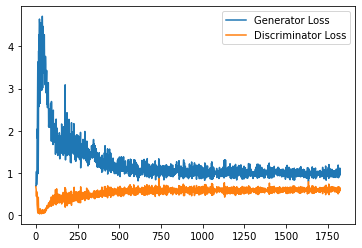

Step 37000: Generator loss: 0.9827282828092575, discriminator loss: 0.6089893095493316


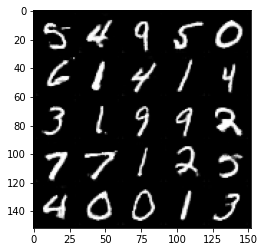

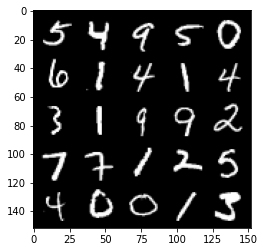

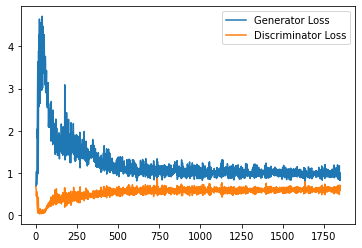

Step 37500: Generator loss: 0.9526610565185547, discriminator loss: 0.605072499036789


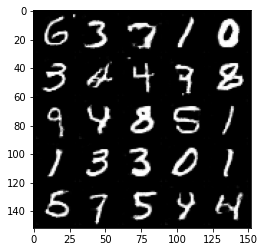

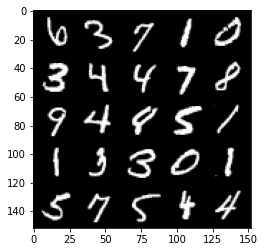

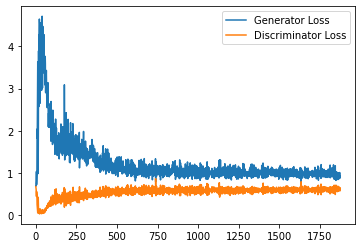

Step 38000: Generator loss: 0.9776567902565002, discriminator loss: 0.6109817522168159


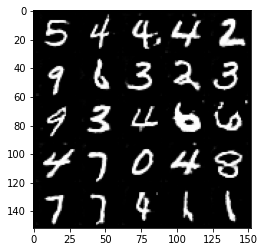

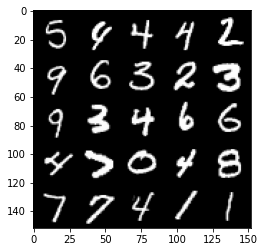

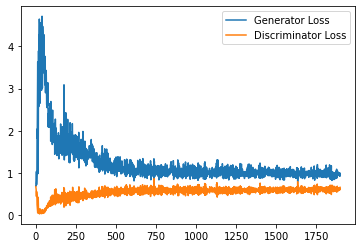

Step 38500: Generator loss: 0.9547278590202332, discriminator loss: 0.5990112988948822


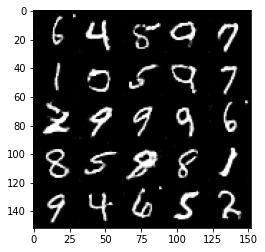

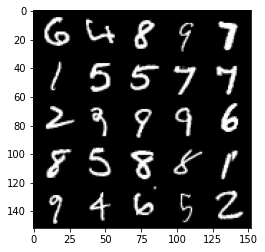

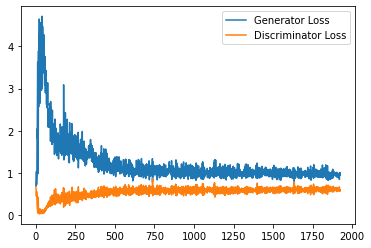

Step 39000: Generator loss: 0.9510266712903976, discriminator loss: 0.6104154944419861


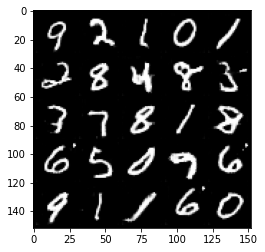

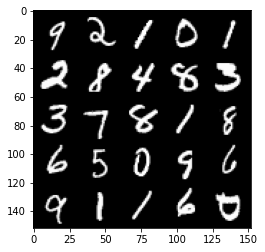

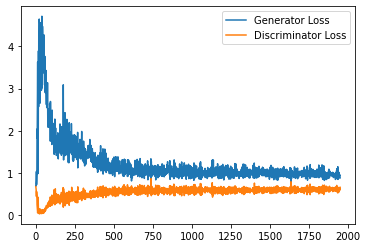

Step 39500: Generator loss: 0.9635293753147125, discriminator loss: 0.6054242205619812


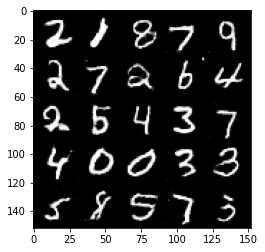

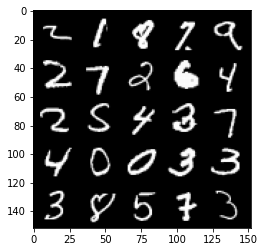

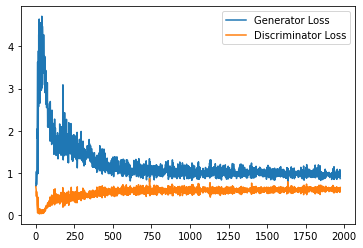

Step 40000: Generator loss: 0.9793915394544601, discriminator loss: 0.606607406437397


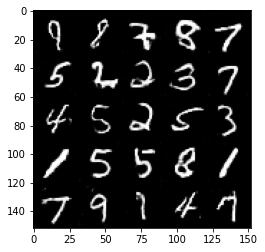

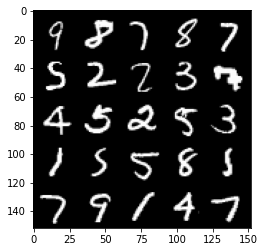

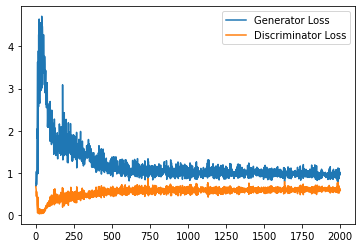

Step 40500: Generator loss: 0.9548530449867249, discriminator loss: 0.6131515315771103


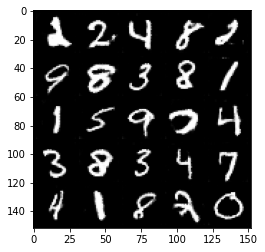

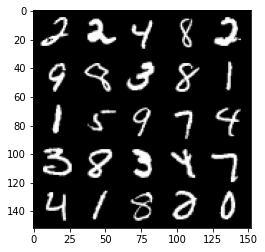

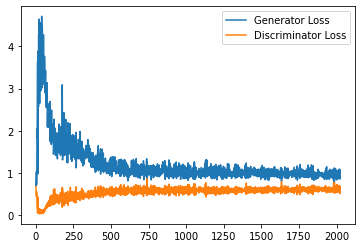

Step 41000: Generator loss: 0.9721119115352631, discriminator loss: 0.6094098051190376


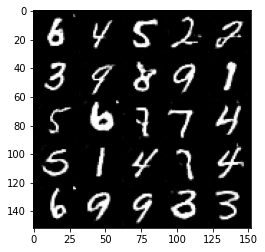

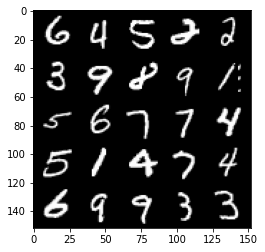

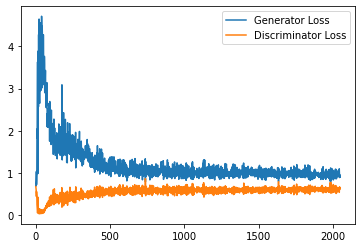

Step 41500: Generator loss: 0.9513332912921906, discriminator loss: 0.6166618443727493


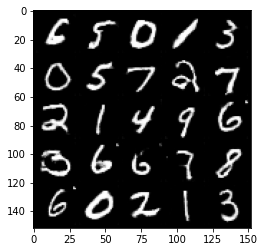

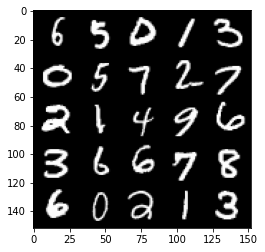

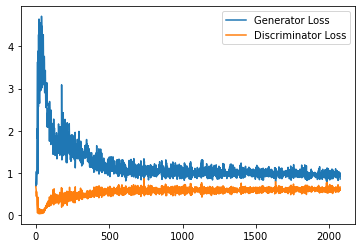

Step 42000: Generator loss: 0.9545405015945435, discriminator loss: 0.6107264259457588


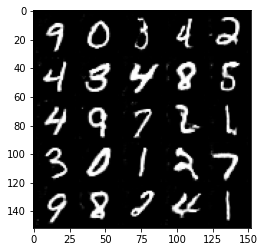

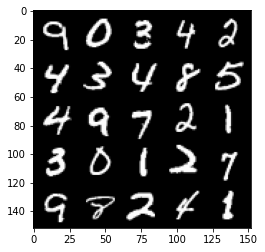

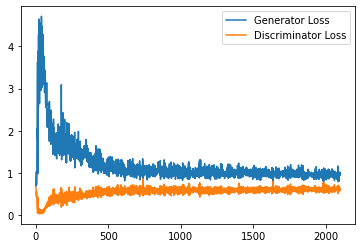

Step 42500: Generator loss: 0.967130459189415, discriminator loss: 0.6043476032018662


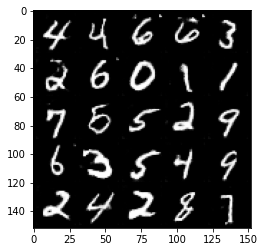

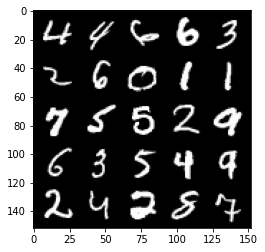

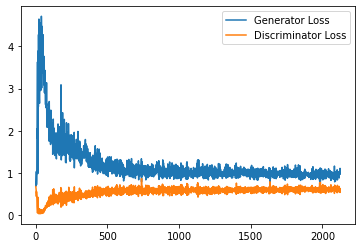

Step 43000: Generator loss: 0.9801314560174942, discriminator loss: 0.6162890654206276


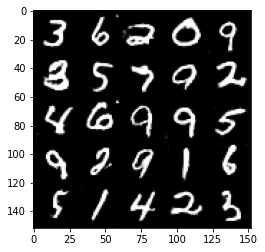

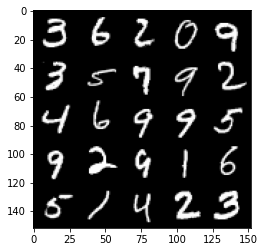

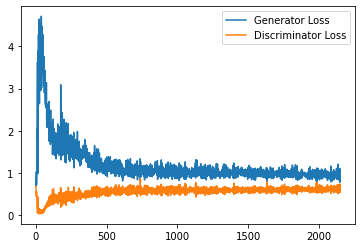

Step 43500: Generator loss: 0.9511725826263427, discriminator loss: 0.6164504448175431


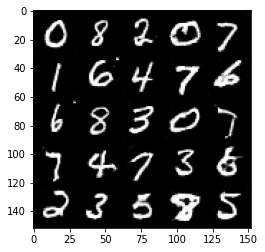

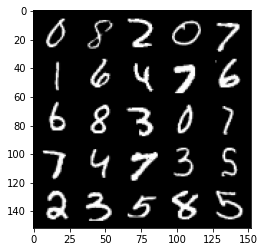

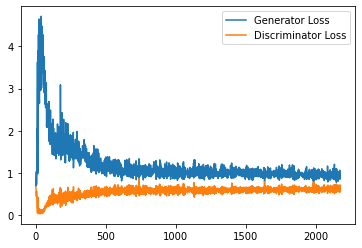

Step 44000: Generator loss: 0.9583213863372803, discriminator loss: 0.6125497243404389


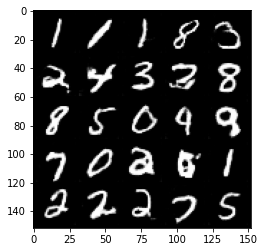

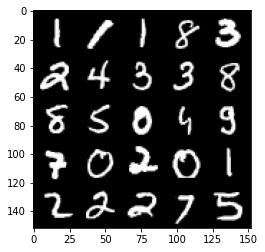

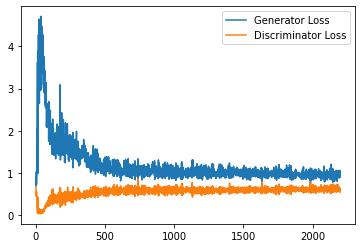

Step 44500: Generator loss: 0.9528887139558793, discriminator loss: 0.6136579450964927


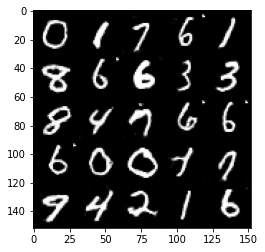

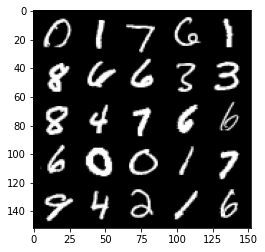

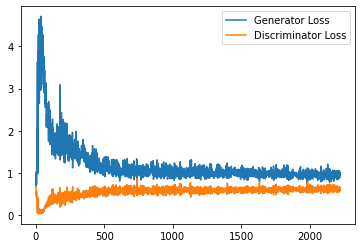

Step 45000: Generator loss: 0.9455763963460923, discriminator loss: 0.6102059567570687


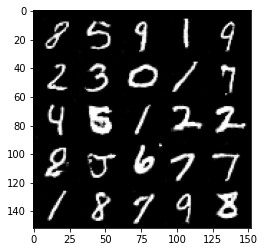

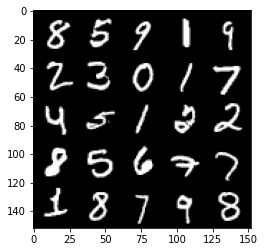

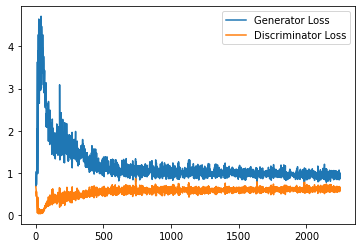

Step 45500: Generator loss: 0.9826183367967606, discriminator loss: 0.6109633628129959


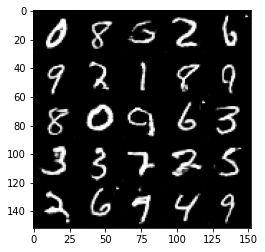

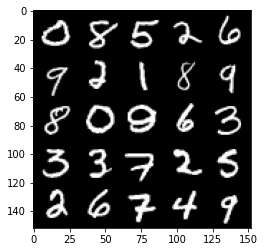

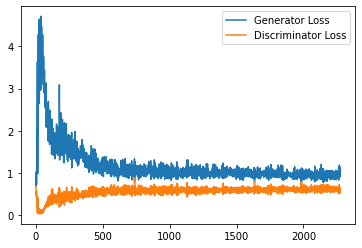

Step 46000: Generator loss: 0.9628366223573684, discriminator loss: 0.6109895567297936


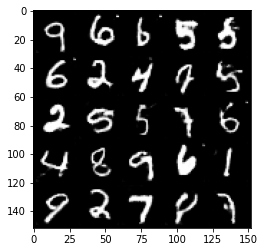

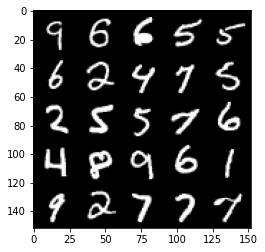

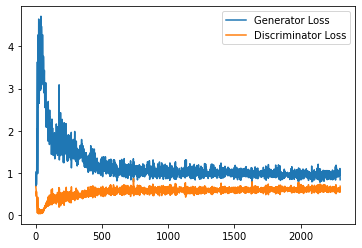

Step 46500: Generator loss: 0.9627793221473694, discriminator loss: 0.6037008299827575


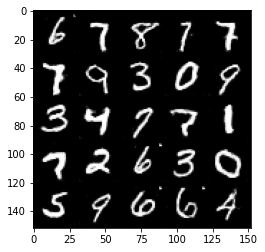

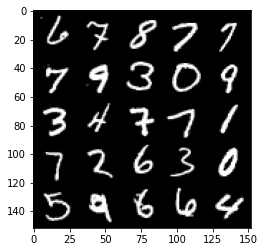

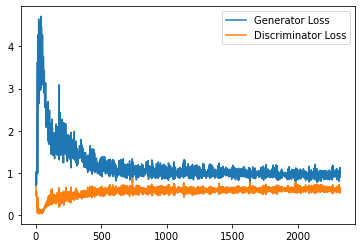

Step 47000: Generator loss: 0.9522898659706116, discriminator loss: 0.6148022906184196


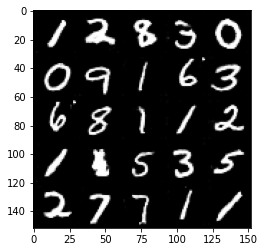

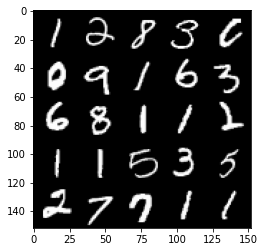

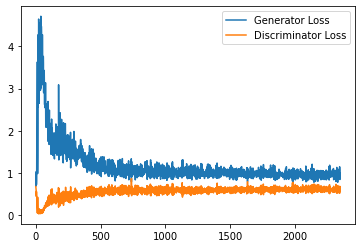

Step 47500: Generator loss: 0.9624042497873306, discriminator loss: 0.609310827434063


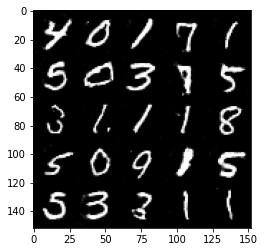

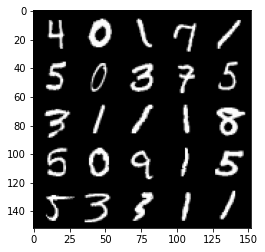

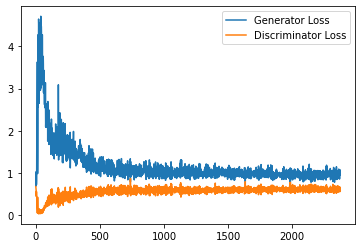

Step 48000: Generator loss: 0.9639665205478668, discriminator loss: 0.6103155173063278


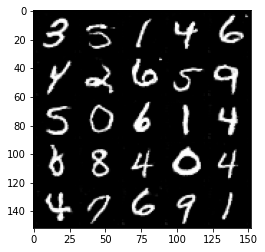

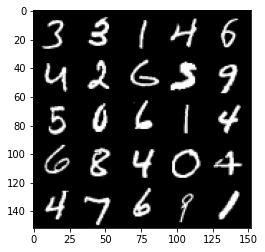

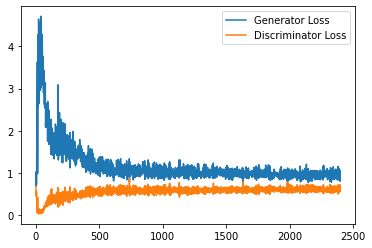

Step 48500: Generator loss: 0.9695248925685882, discriminator loss: 0.6117739074230194


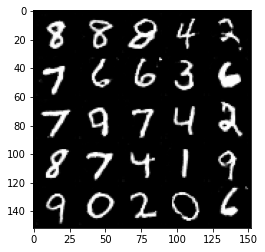

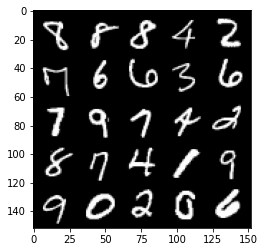

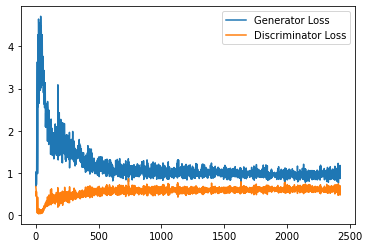

Step 49000: Generator loss: 0.977730671286583, discriminator loss: 0.6099157437086106


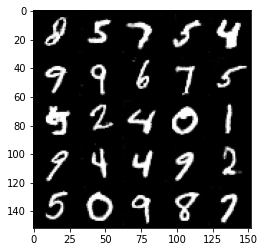

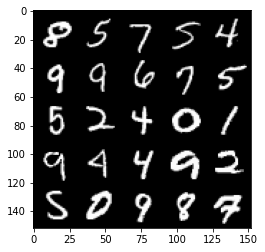

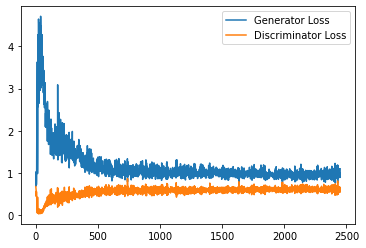

Step 49500: Generator loss: 0.9689545192718506, discriminator loss: 0.6085411270260811


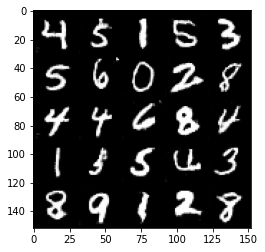

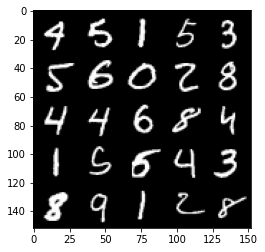

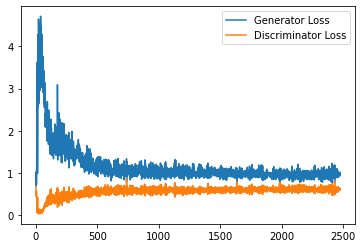

Step 50000: Generator loss: 0.9828817664384842, discriminator loss: 0.6103703638315201


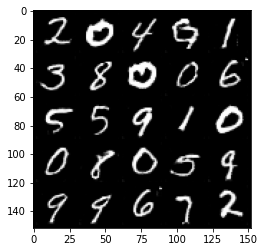

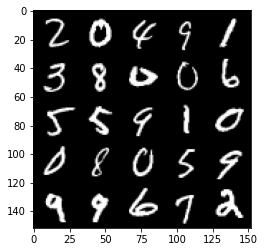

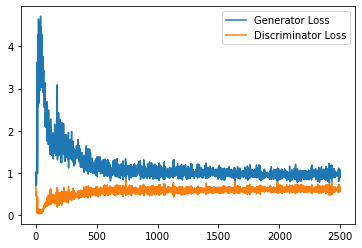

Step 50500: Generator loss: 0.9504086898565293, discriminator loss: 0.6088239739537239


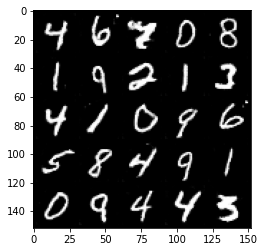

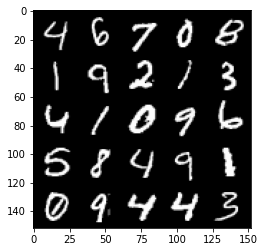

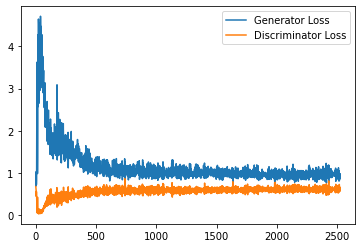

Step 51000: Generator loss: 0.9542523953914642, discriminator loss: 0.6071187480688095


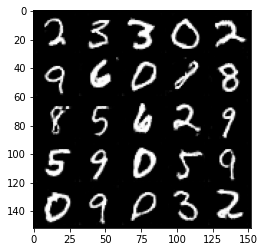

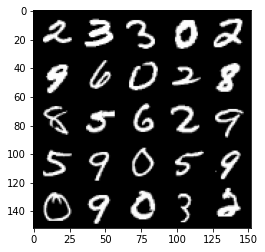

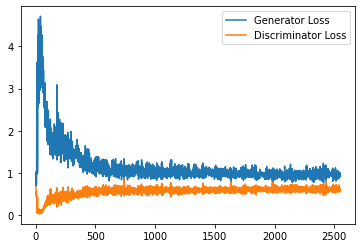

Step 51500: Generator loss: 0.9808385901451111, discriminator loss: 0.6093740219473839


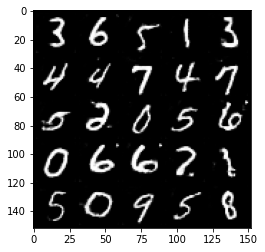

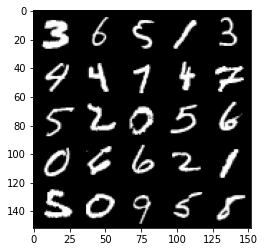

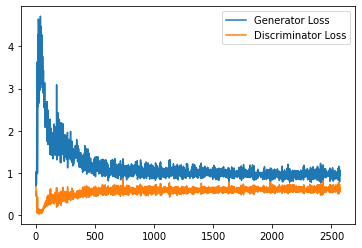

Step 52000: Generator loss: 0.9571046844720841, discriminator loss: 0.6114379324913025


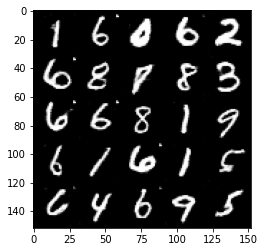

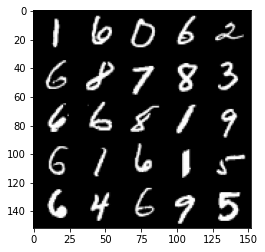

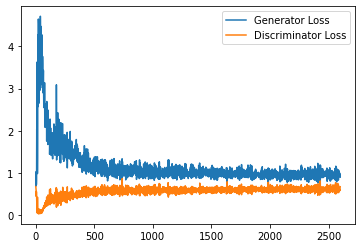

Step 52500: Generator loss: 0.9682934865951538, discriminator loss: 0.6106963299512863


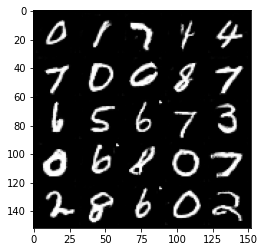

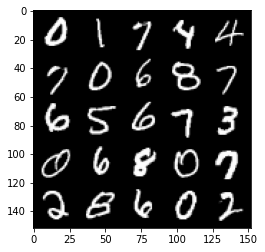

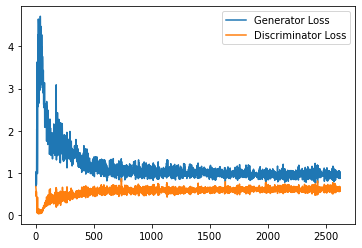

Step 53000: Generator loss: 0.9508055011034012, discriminator loss: 0.6161045899987221


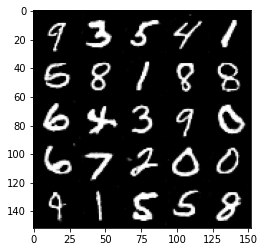

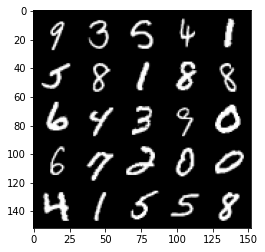

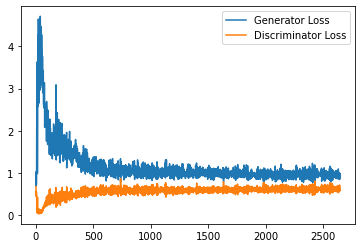

Step 53500: Generator loss: 0.9668765618801117, discriminator loss: 0.6096732189059257


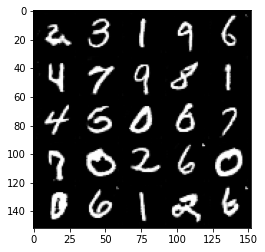

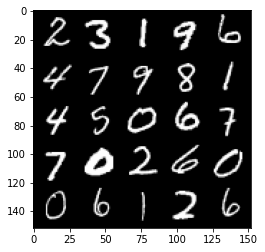

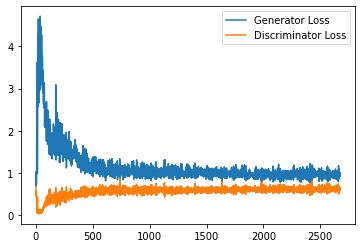

Step 54000: Generator loss: 0.9583504654169083, discriminator loss: 0.6125643298029899


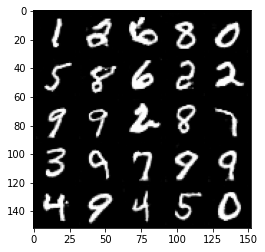

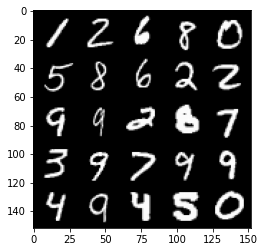

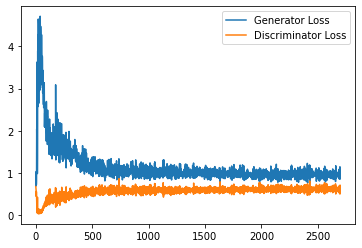

Step 54500: Generator loss: 0.9729913339614868, discriminator loss: 0.6062532889246941


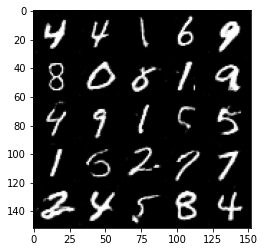

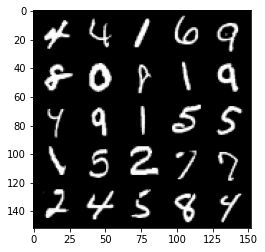

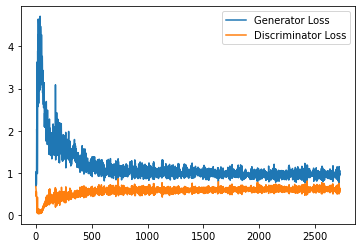

Step 55000: Generator loss: 0.9464295537471771, discriminator loss: 0.6145331068038941


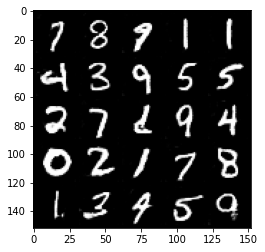

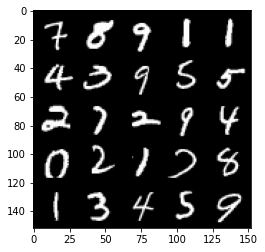

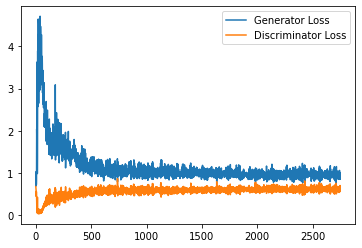

Step 55500: Generator loss: 0.940351432800293, discriminator loss: 0.6049782468676567


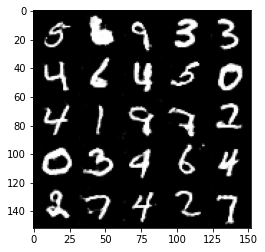

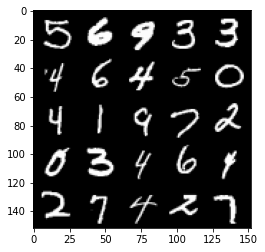

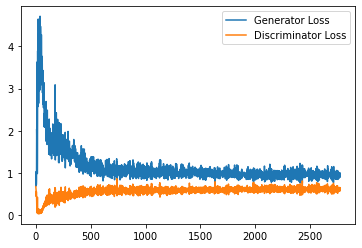

Step 56000: Generator loss: 0.9953976130485535, discriminator loss: 0.6070207263231278


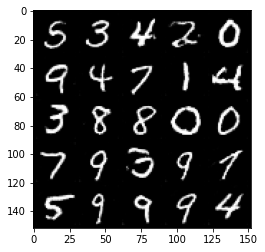

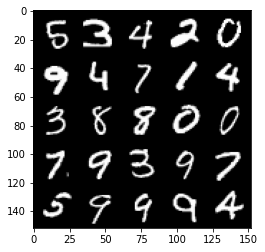

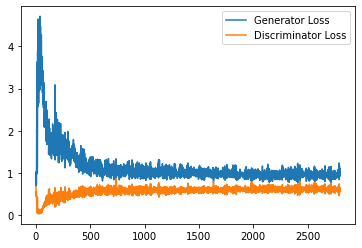

Step 56500: Generator loss: 0.9621156556606293, discriminator loss: 0.6068020561933517


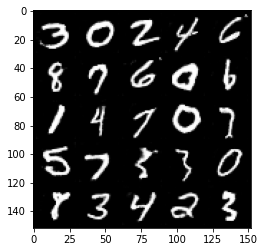

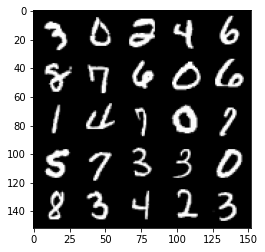

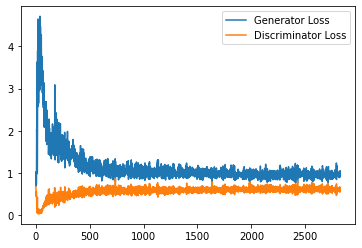

Step 57000: Generator loss: 0.9750316587686538, discriminator loss: 0.6046360222697258


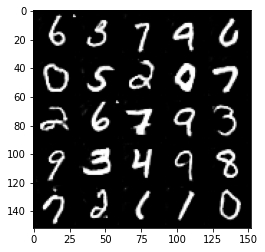

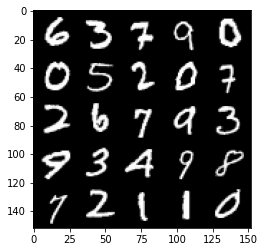

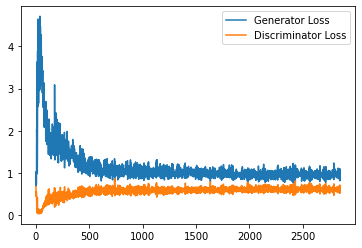

Step 57500: Generator loss: 0.9602174715995788, discriminator loss: 0.6059923313856125


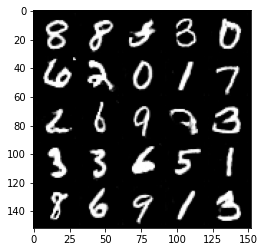

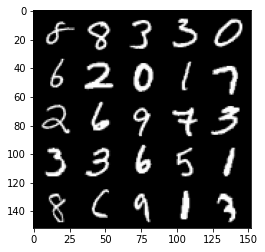

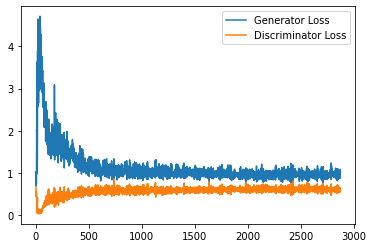

Step 58000: Generator loss: 0.9752002108097076, discriminator loss: 0.6067085497379303


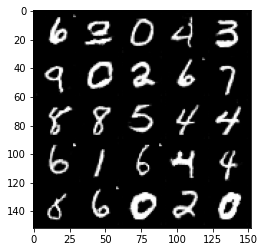

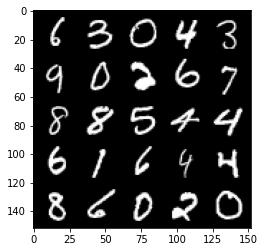

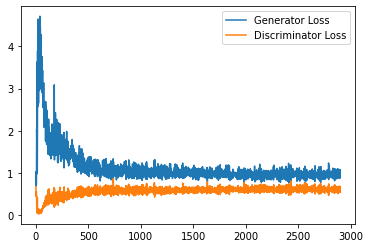

Step 58500: Generator loss: 0.9912185935974122, discriminator loss: 0.6041080172657967


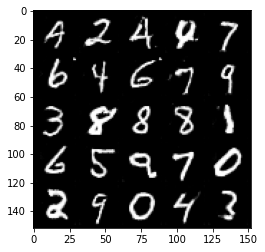

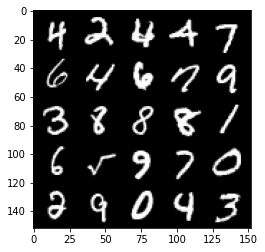

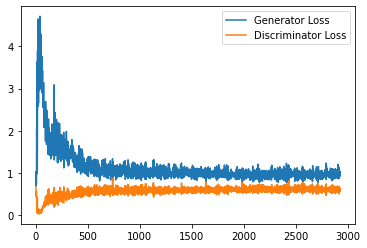

Step 59000: Generator loss: 0.9719967031478882, discriminator loss: 0.6076773943305016


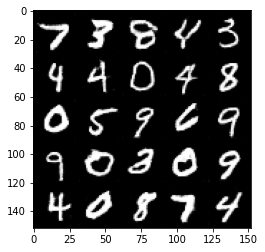

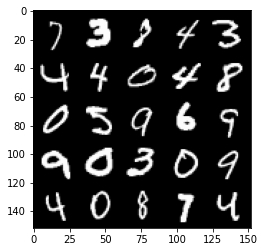

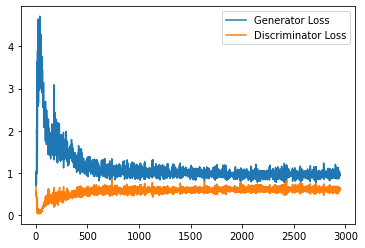

Step 59500: Generator loss: 0.9739218114614486, discriminator loss: 0.6085765744447709


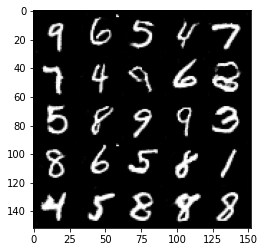

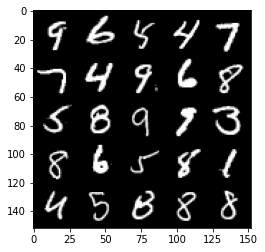

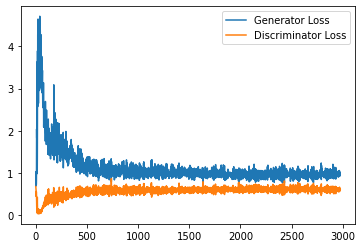

Step 60000: Generator loss: 1.0034273508787155, discriminator loss: 0.6024149112701416


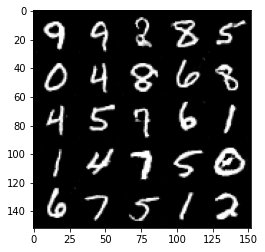

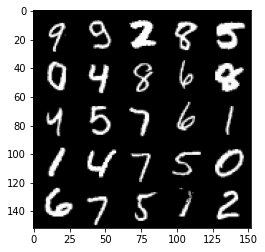

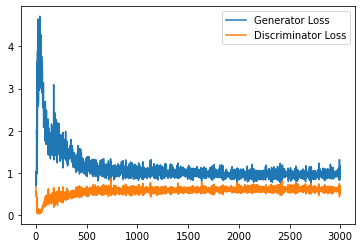

Step 60500: Generator loss: 0.9562623310089111, discriminator loss: 0.6031411312222481


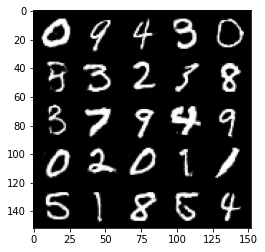

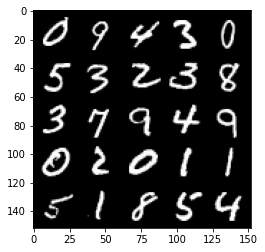

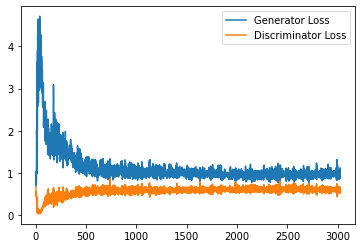

Step 61000: Generator loss: 0.9626745336055755, discriminator loss: 0.6094570299386978


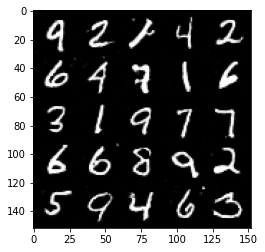

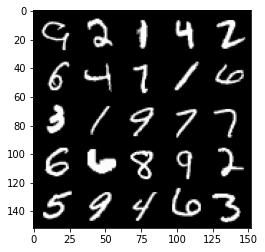

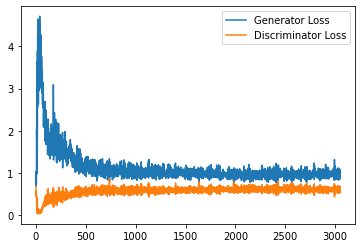

Step 61500: Generator loss: 0.9706889275312424, discriminator loss: 0.6069725468754769


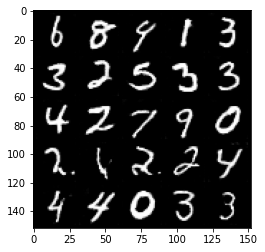

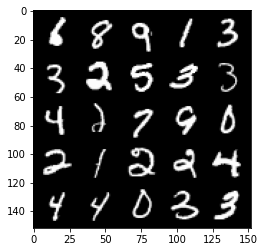

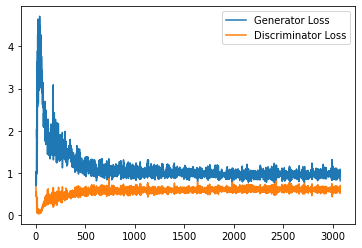

Step 62000: Generator loss: 0.9764524974822998, discriminator loss: 0.6053689575791359


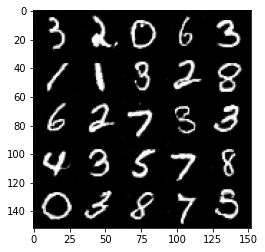

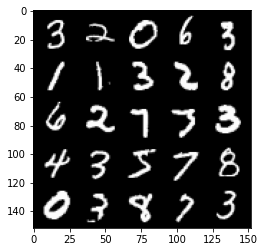

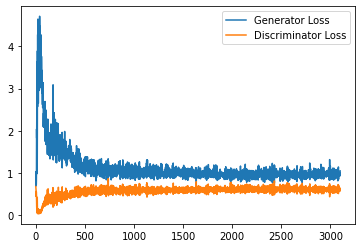

Step 62500: Generator loss: 0.9864449995756149, discriminator loss: 0.603816649734974


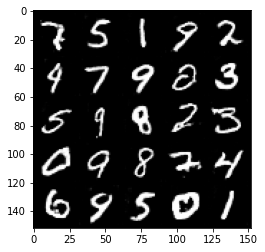

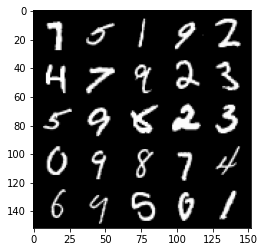

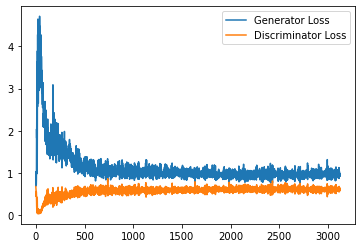

Step 63000: Generator loss: 0.9599164761304856, discriminator loss: 0.6071365913748741


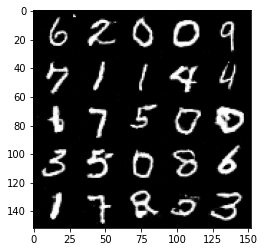

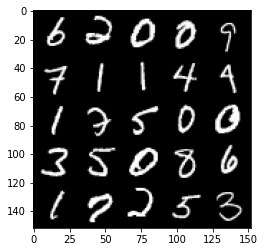

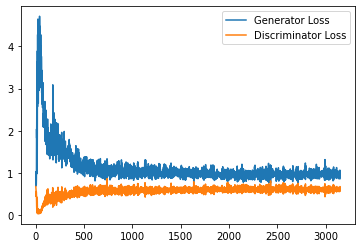

Step 63500: Generator loss: 0.9945841149091721, discriminator loss: 0.5995403234362602


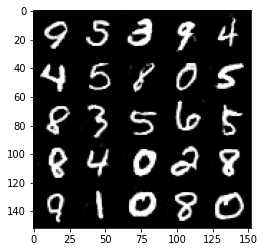

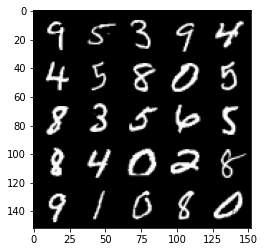

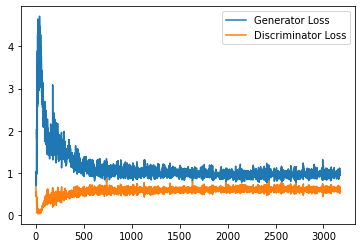

Step 64000: Generator loss: 0.9781297990083695, discriminator loss: 0.6087787651419639


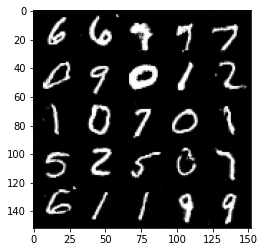

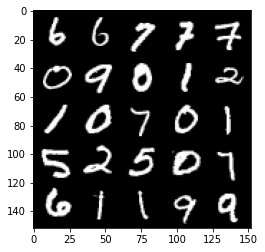

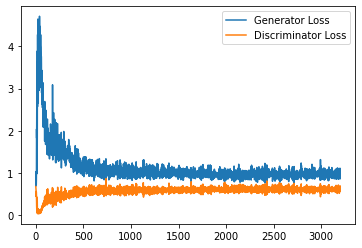

Step 64500: Generator loss: 0.9600661829710007, discriminator loss: 0.6046665952801704


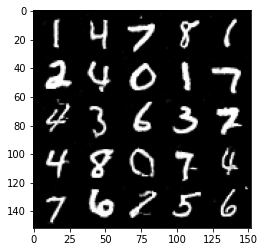

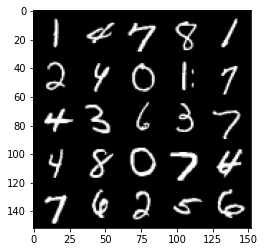

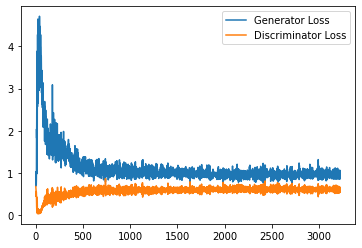

Step 65000: Generator loss: 0.9596782150268555, discriminator loss: 0.608618860065937


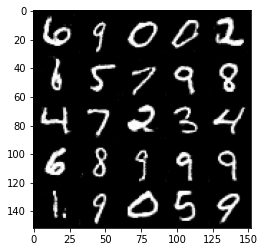

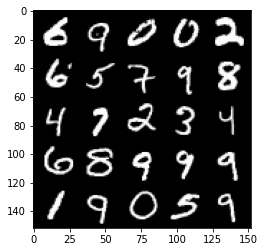

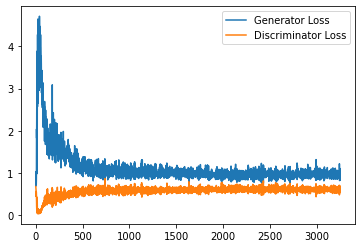

Step 65500: Generator loss: 0.9667613257169724, discriminator loss: 0.5998371995687485


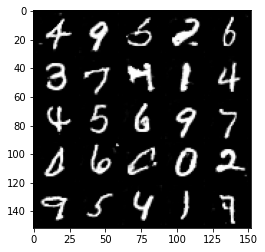

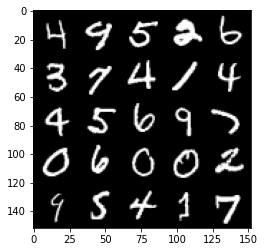

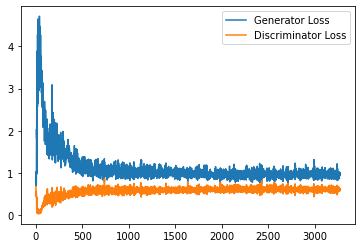

Step 66000: Generator loss: 0.9871170009374619, discriminator loss: 0.605209721326828


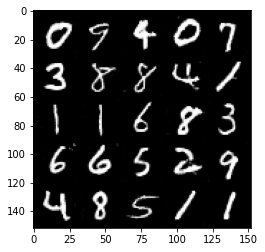

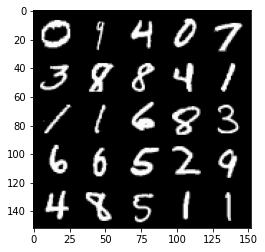

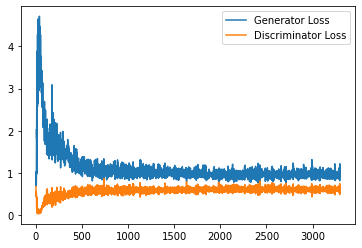

Step 66500: Generator loss: 0.9623033676147461, discriminator loss: 0.60425234156847


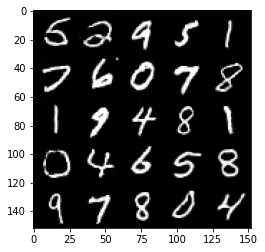

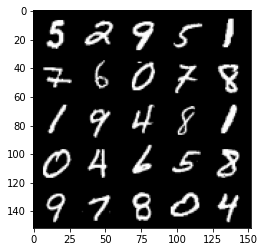

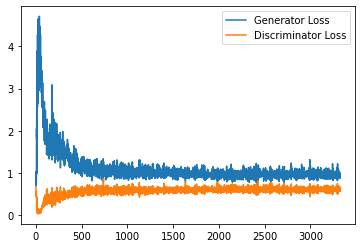

Step 67000: Generator loss: 0.9549606777429581, discriminator loss: 0.608740847826004


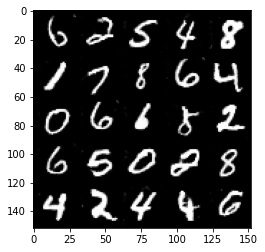

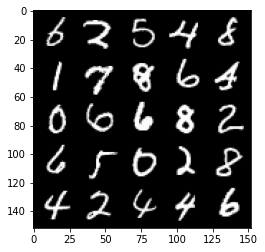

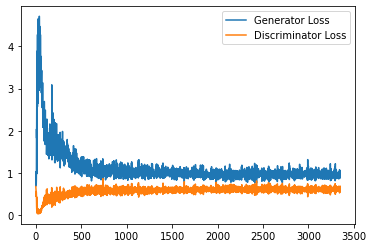

Step 67500: Generator loss: 0.969785945057869, discriminator loss: 0.6089260792136192


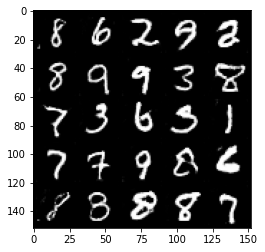

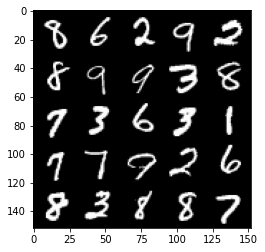

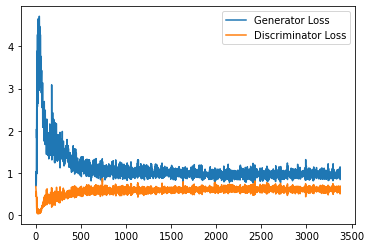

Step 68000: Generator loss: 0.9788527493476867, discriminator loss: 0.6018831003904342


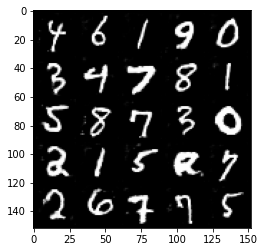

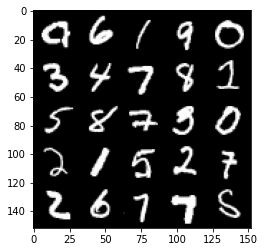

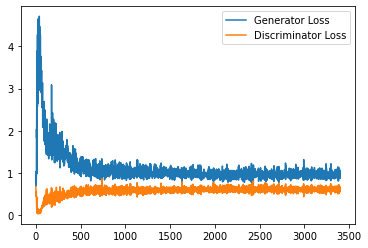

Step 68500: Generator loss: 0.9723252884149551, discriminator loss: 0.6095889154672622


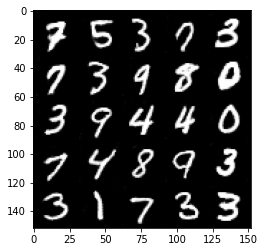

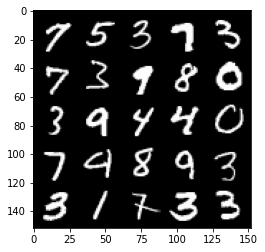

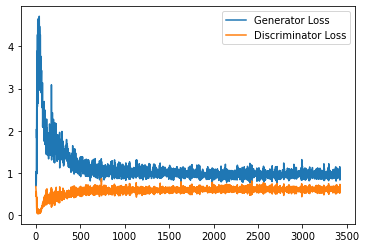

Step 69000: Generator loss: 0.9794526880979538, discriminator loss: 0.602556233882904


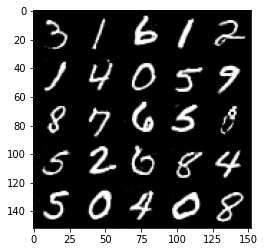

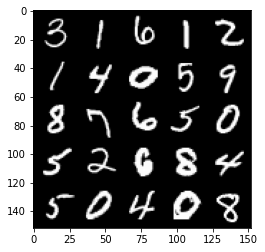

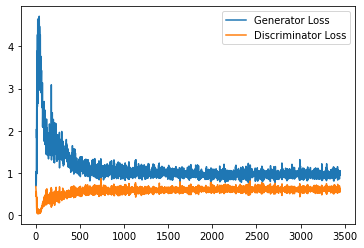

Step 69500: Generator loss: 0.978722677230835, discriminator loss: 0.6049600266218186


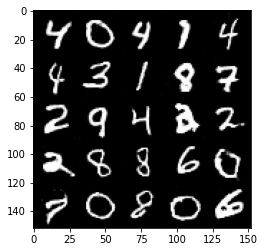

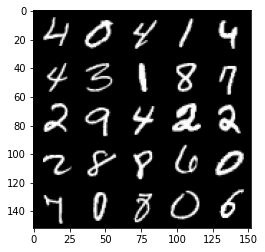

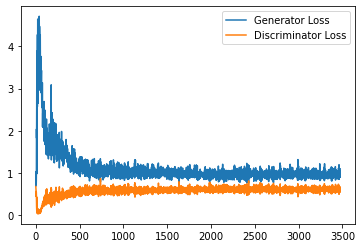

Step 70000: Generator loss: 0.9604780207872391, discriminator loss: 0.6043726277351379


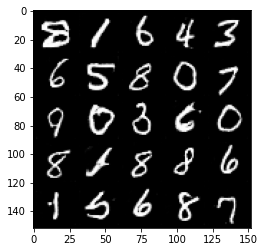

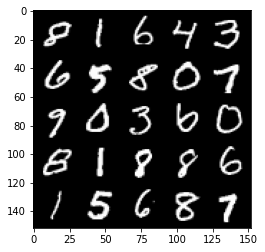

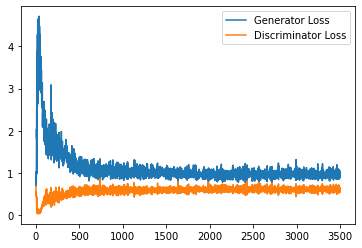

Step 70500: Generator loss: 0.9707097576856614, discriminator loss: 0.6052078929543495


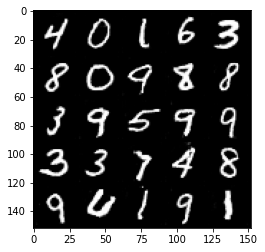

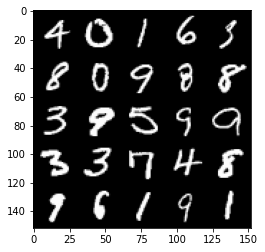

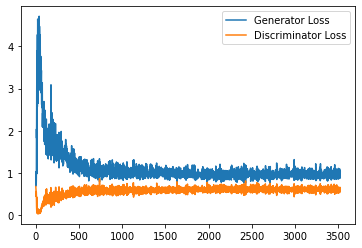

Step 71000: Generator loss: 0.9833736528158188, discriminator loss: 0.609672962129116


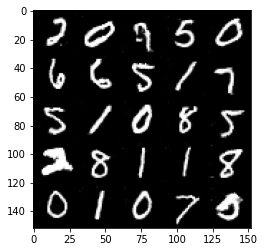

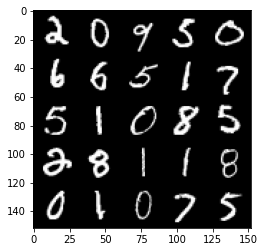

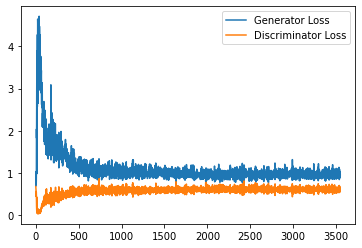

Step 71500: Generator loss: 0.9733621925115585, discriminator loss: 0.606308694422245


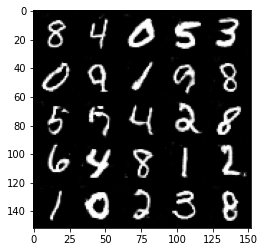

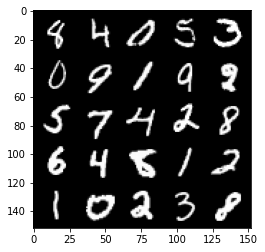

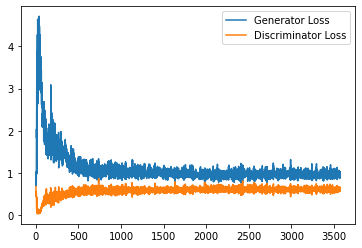

Step 72000: Generator loss: 0.9790433428287506, discriminator loss: 0.6081119405031205


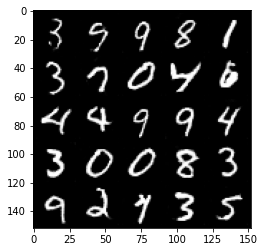

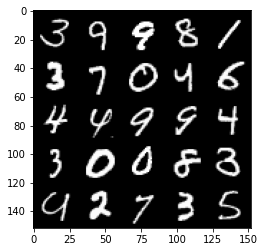

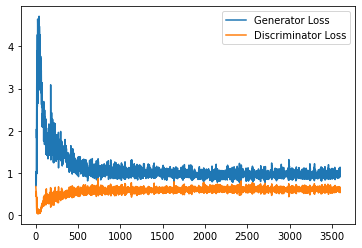

Step 72500: Generator loss: 0.9601367434263229, discriminator loss: 0.610691951572895


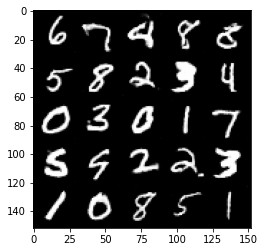

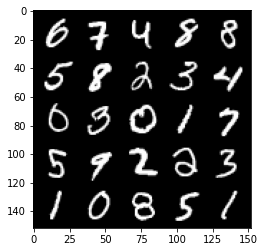

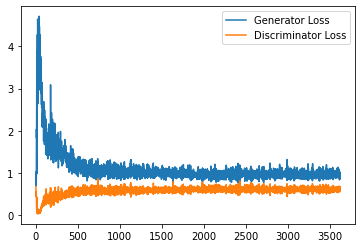

Step 73000: Generator loss: 0.9629397886991501, discriminator loss: 0.6068510726094246


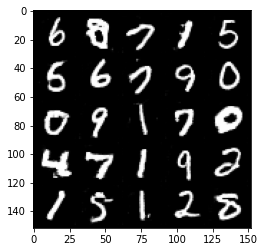

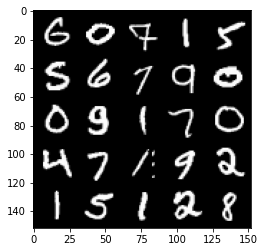

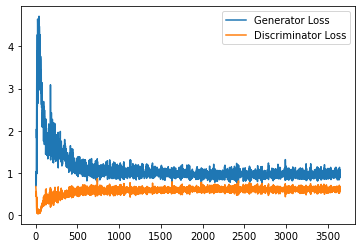

Step 73500: Generator loss: 0.9652299468517304, discriminator loss: 0.607369825720787


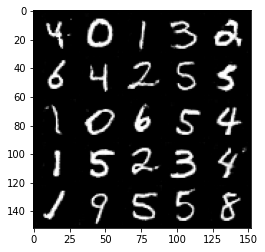

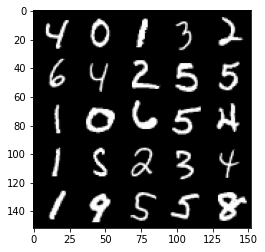

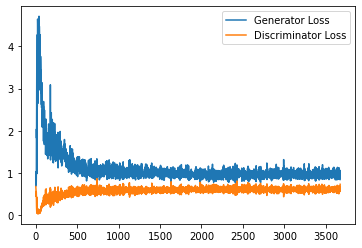

Step 74000: Generator loss: 0.980365776181221, discriminator loss: 0.6038871230483055


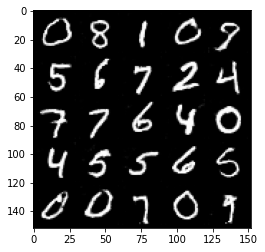

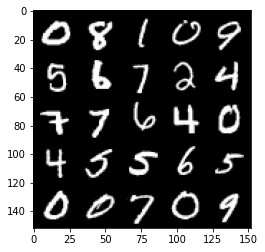

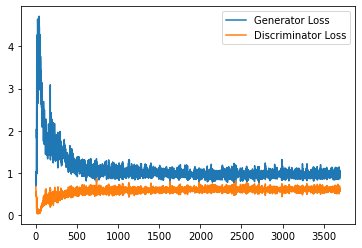

Step 74500: Generator loss: 0.9594460166692734, discriminator loss: 0.6134140783548355


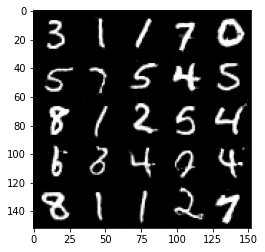

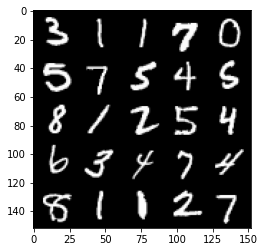

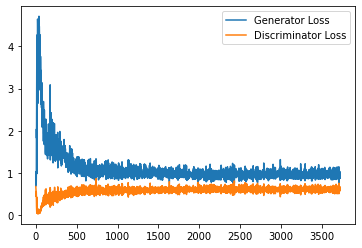

Step 75000: Generator loss: 0.9634771771430969, discriminator loss: 0.6057288913130761


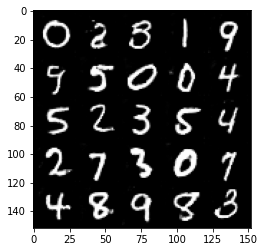

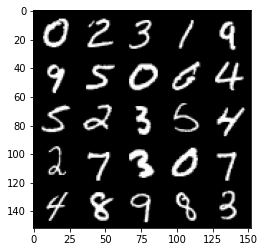

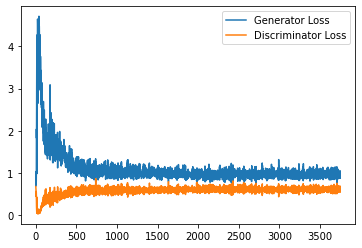

Step 75500: Generator loss: 0.9618900703191757, discriminator loss: 0.6094333311319351


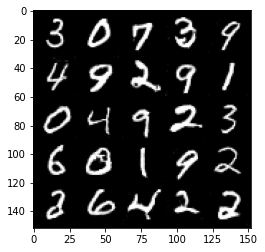

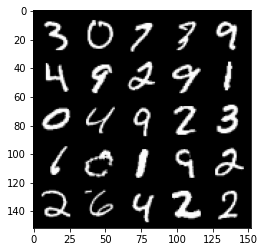

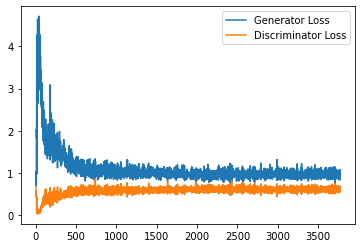

Step 76000: Generator loss: 0.955199256181717, discriminator loss: 0.6058168942332268


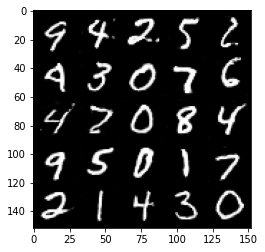

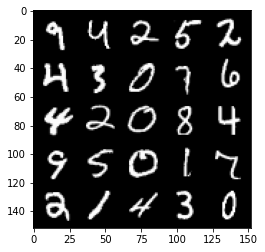

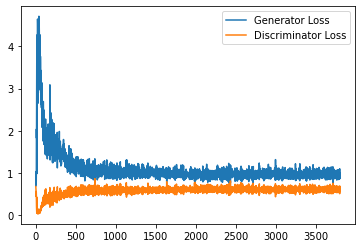

Step 76500: Generator loss: 0.9747208724021912, discriminator loss: 0.6078269370198249


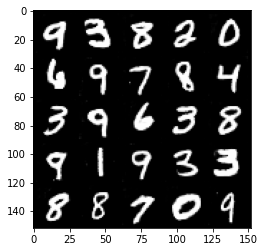

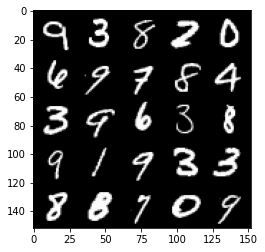

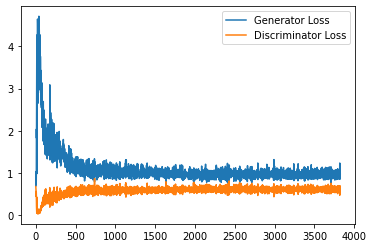

Step 77000: Generator loss: 0.9661586220264435, discriminator loss: 0.6013258195519448


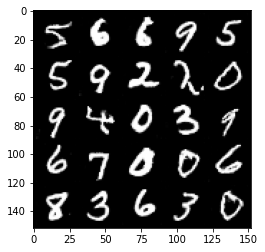

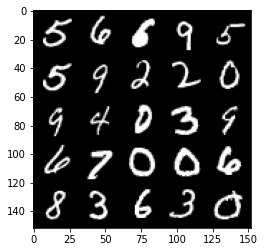

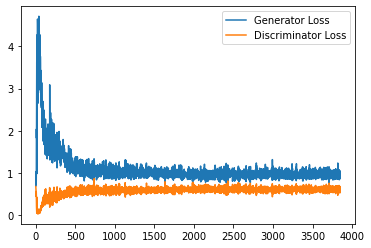

Step 77500: Generator loss: 0.9549292123317719, discriminator loss: 0.6056177397966385


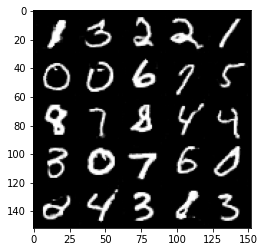

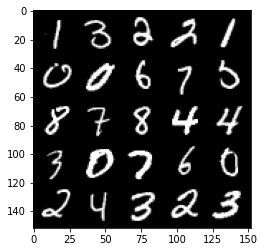

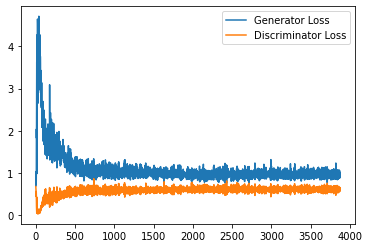

Step 78000: Generator loss: 0.9699709796905518, discriminator loss: 0.6038620012402535


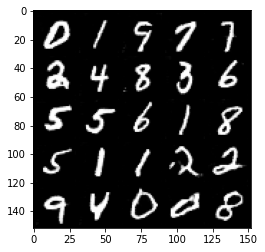

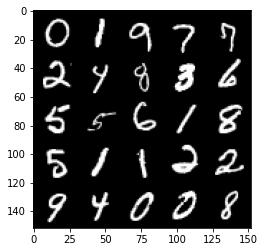

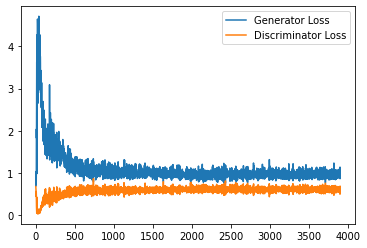

Step 78500: Generator loss: 0.9626317957639694, discriminator loss: 0.6060191622972488


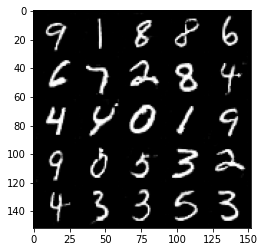

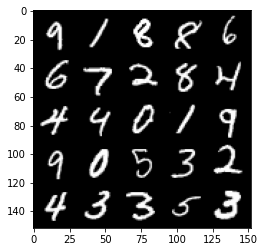

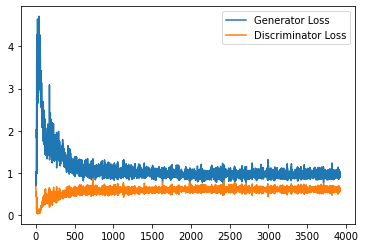

Step 79000: Generator loss: 0.9696779910326004, discriminator loss: 0.6083587933778762


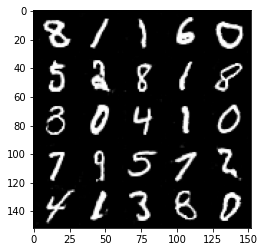

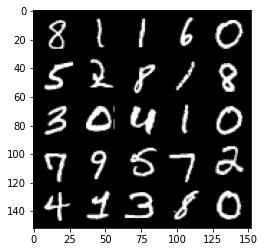

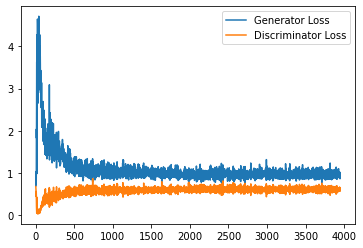

Step 79500: Generator loss: 0.9598424382209778, discriminator loss: 0.6081238664388656


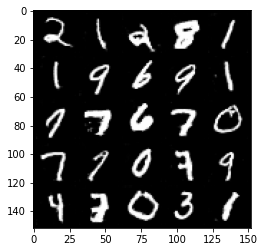

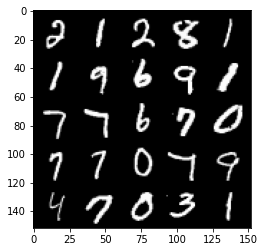

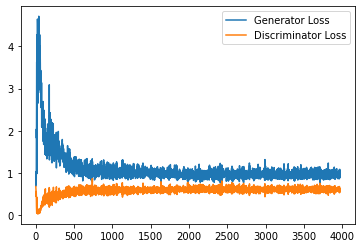

Step 80000: Generator loss: 0.9716629378795624, discriminator loss: 0.6106294841170311


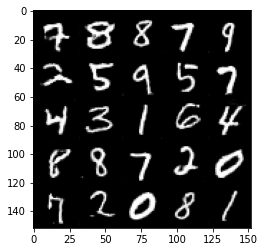

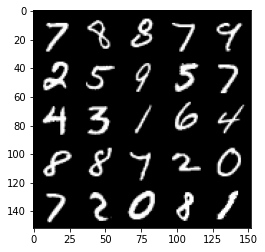

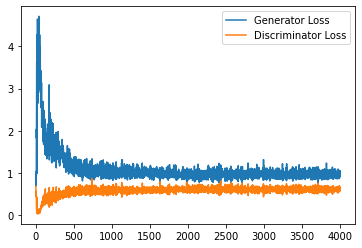

Step 80500: Generator loss: 0.9526550707817077, discriminator loss: 0.6116013691425324


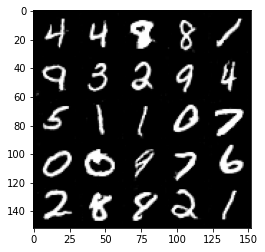

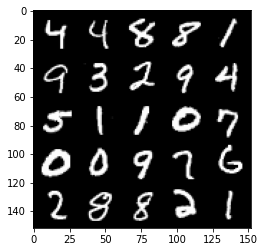

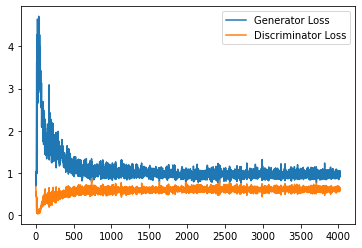

Step 81000: Generator loss: 0.968014413356781, discriminator loss: 0.6068118942379952


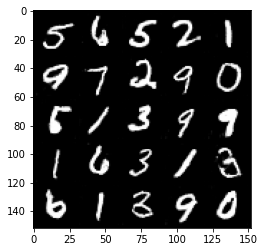

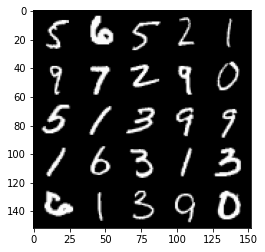

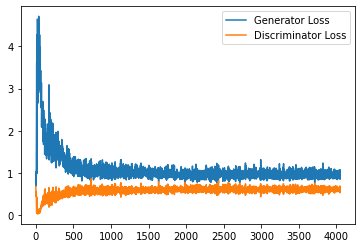

Step 81500: Generator loss: 0.9646720911264419, discriminator loss: 0.6113165052533149


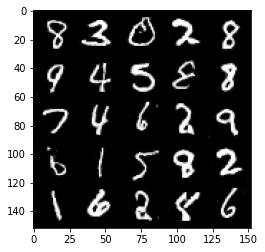

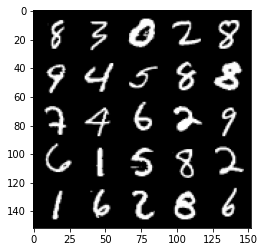

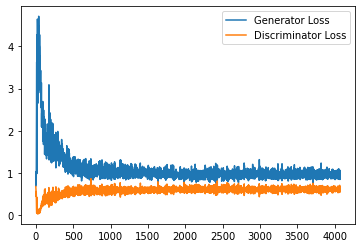

Step 82000: Generator loss: 0.9607482495307922, discriminator loss: 0.6075481677055359


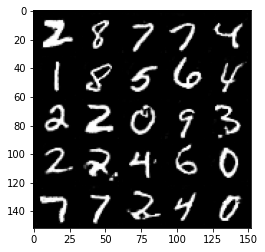

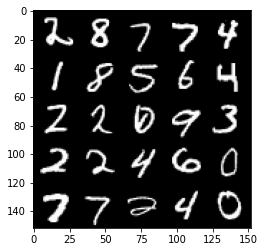

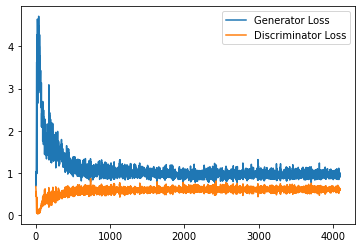

Step 82500: Generator loss: 0.946759917974472, discriminator loss: 0.6088653874993324


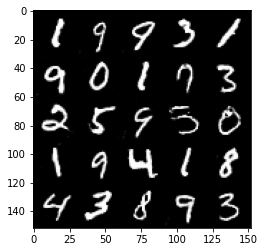

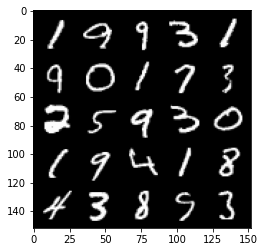

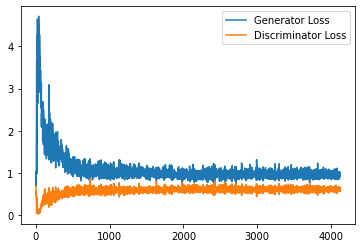

Step 83000: Generator loss: 0.9438134763240814, discriminator loss: 0.6104405542612076


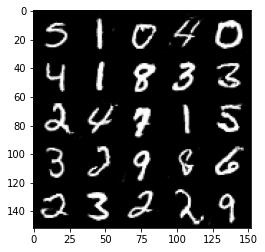

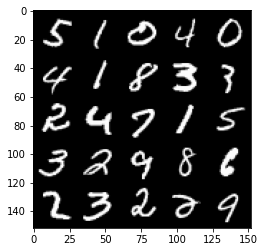

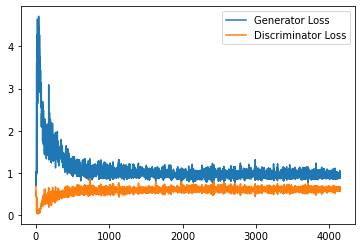

Step 83500: Generator loss: 0.9511689981222152, discriminator loss: 0.6091420487165451


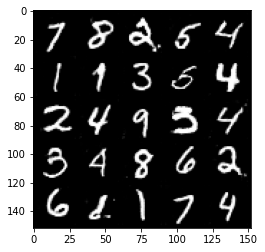

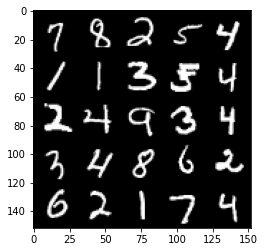

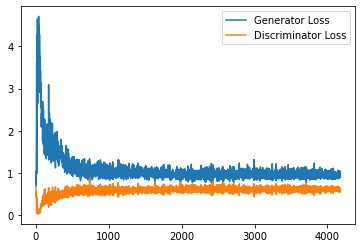

Step 84000: Generator loss: 0.9557847341299057, discriminator loss: 0.6132573434710502


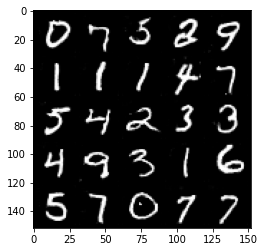

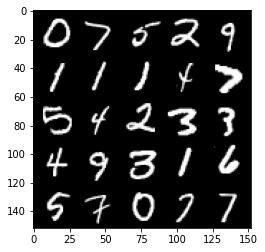

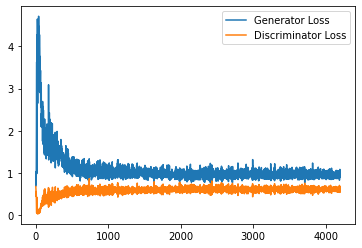

Step 84500: Generator loss: 0.9632729978561402, discriminator loss: 0.6147407323122025


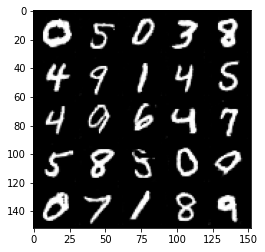

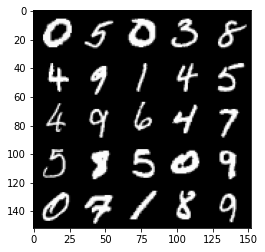

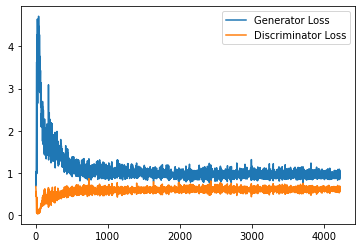

Step 85000: Generator loss: 0.9735975670814514, discriminator loss: 0.6130471804738045


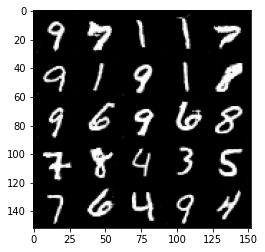

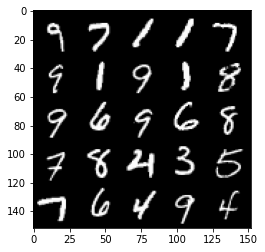

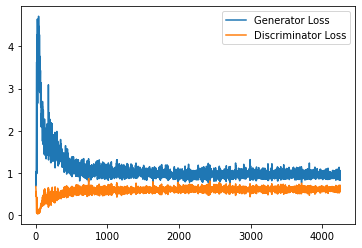

Step 85500: Generator loss: 0.9632523224353791, discriminator loss: 0.613550200521946


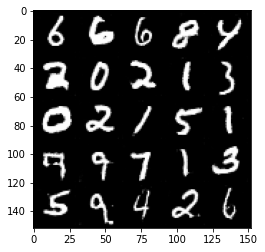

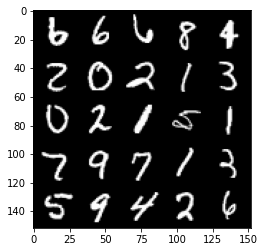

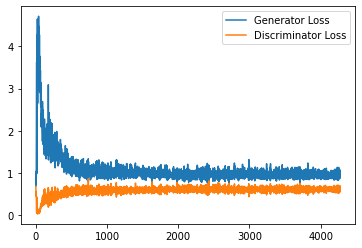

Step 86000: Generator loss: 0.9560070225000381, discriminator loss: 0.6087327871322632


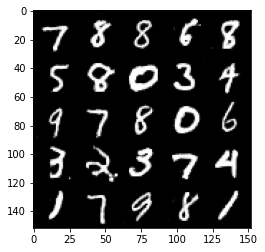

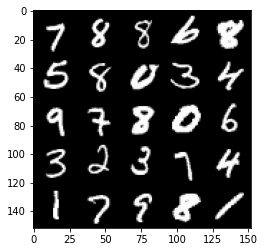

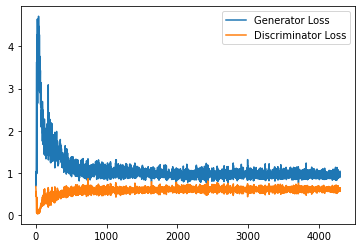

Step 86500: Generator loss: 0.9630900056362152, discriminator loss: 0.6118479982018471


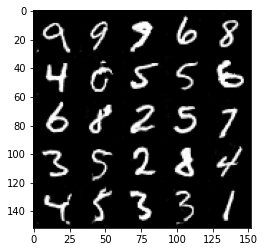

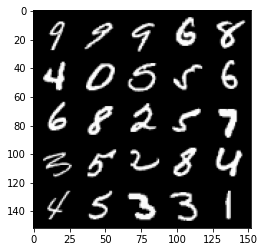

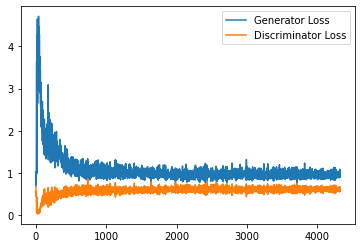

Step 87000: Generator loss: 0.9505952339172363, discriminator loss: 0.6128198526501656


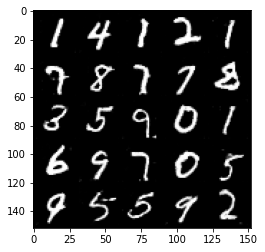

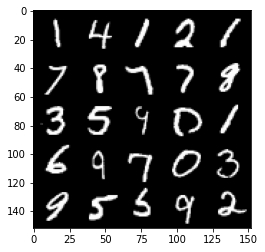

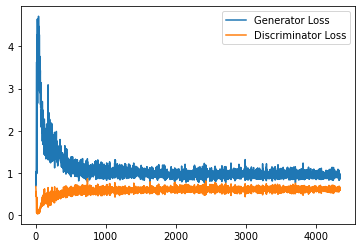

Step 87500: Generator loss: 0.9474711842536926, discriminator loss: 0.6146839082837104


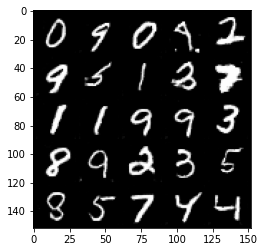

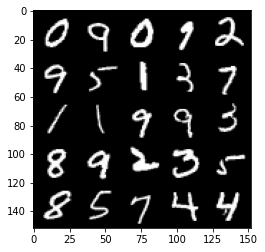

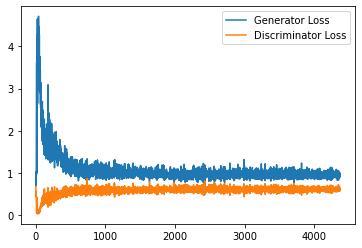

Step 88000: Generator loss: 0.9401050560474395, discriminator loss: 0.6155524078607559


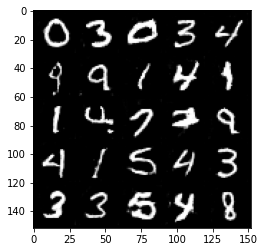

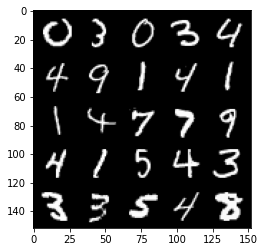

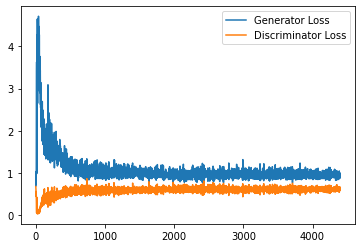

Step 88500: Generator loss: 0.9456999679803848, discriminator loss: 0.6163442591428757


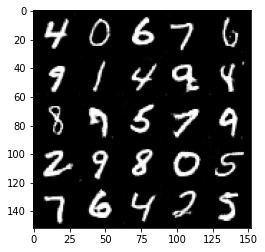

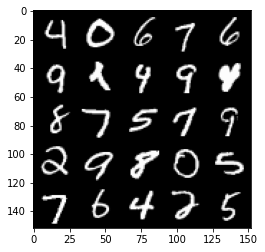

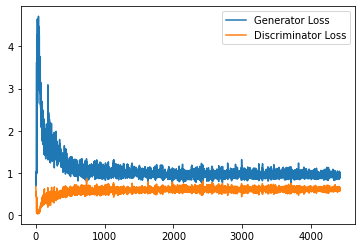

Step 89000: Generator loss: 0.953133016705513, discriminator loss: 0.6154969051480293


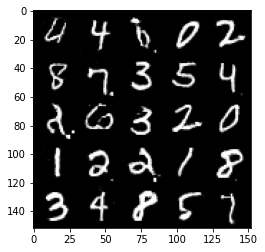

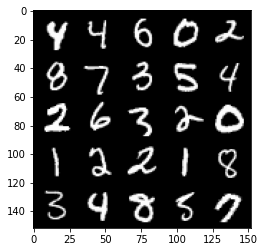

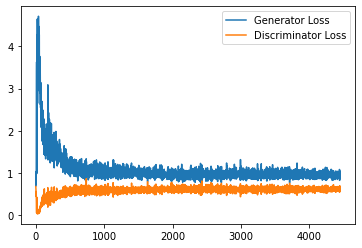

Step 89500: Generator loss: 0.9343775647878647, discriminator loss: 0.6205136538147926


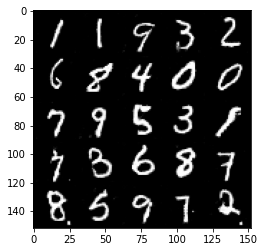

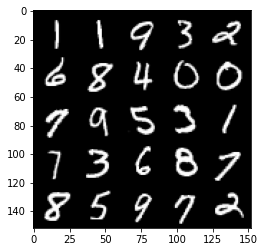

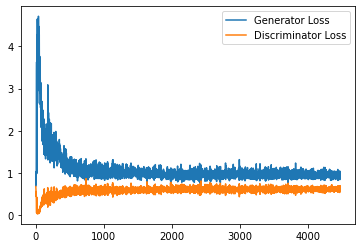

Step 90000: Generator loss: 0.9707825206518174, discriminator loss: 0.6126769394874573


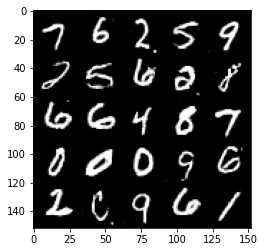

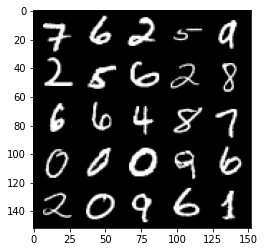

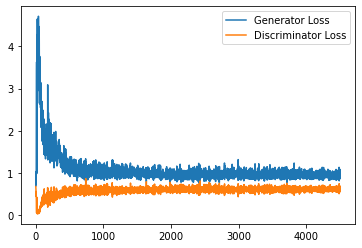

Step 90500: Generator loss: 0.9502752575874328, discriminator loss: 0.6169767915010452


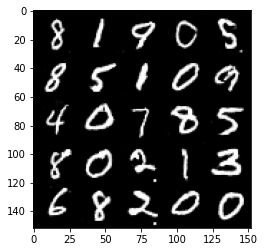

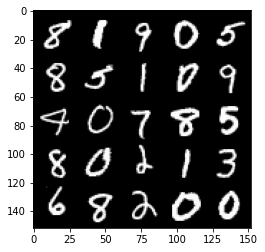

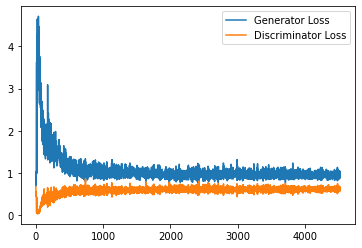

Step 91000: Generator loss: 0.9583344157934189, discriminator loss: 0.6175522176623345


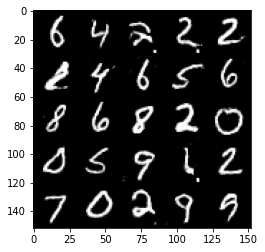

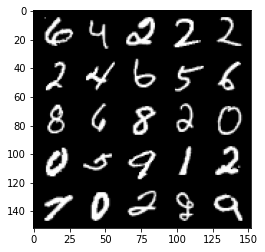

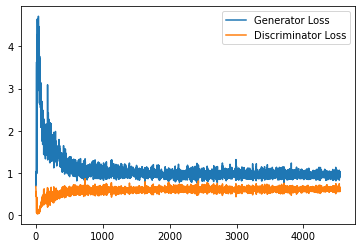

Step 91500: Generator loss: 0.9365508726835251, discriminator loss: 0.6194314717054367


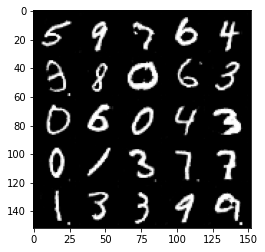

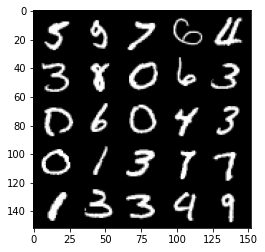

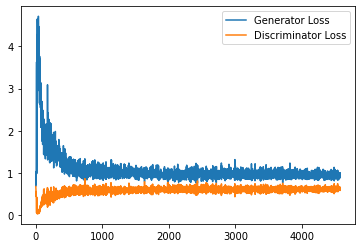

Step 92000: Generator loss: 0.9575010219812393, discriminator loss: 0.6097281698584557


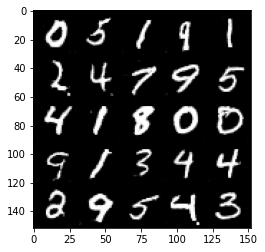

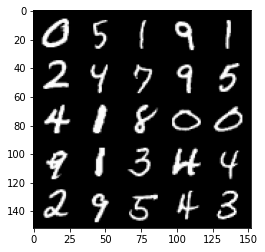

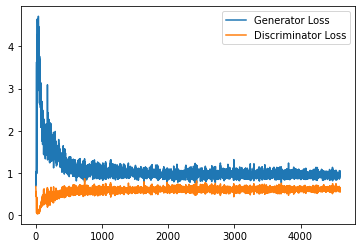

Step 92500: Generator loss: 0.9419510082006455, discriminator loss: 0.6228893438577652


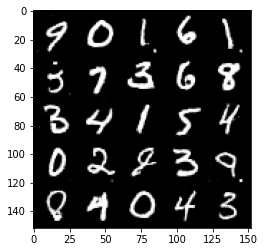

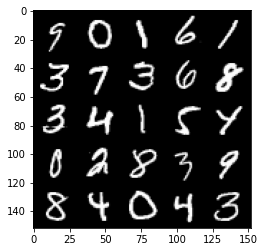

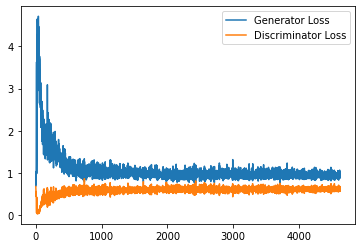

Step 93000: Generator loss: 0.9327927713394165, discriminator loss: 0.6207082872986793


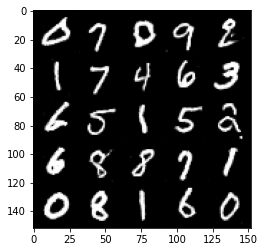

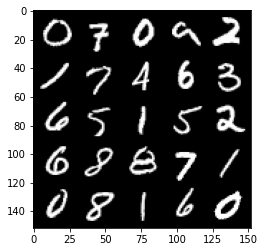

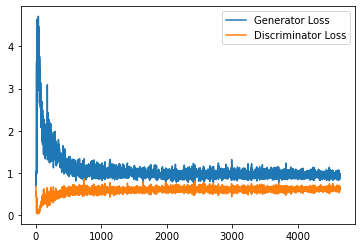

Step 93500: Generator loss: 0.9435541894435883, discriminator loss: 0.6206310527920723


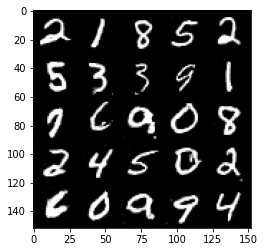

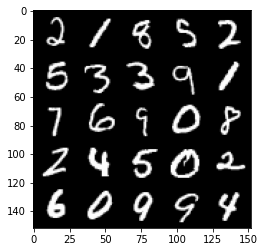

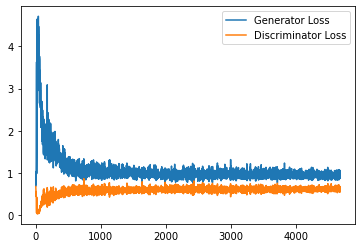

In [26]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [27]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

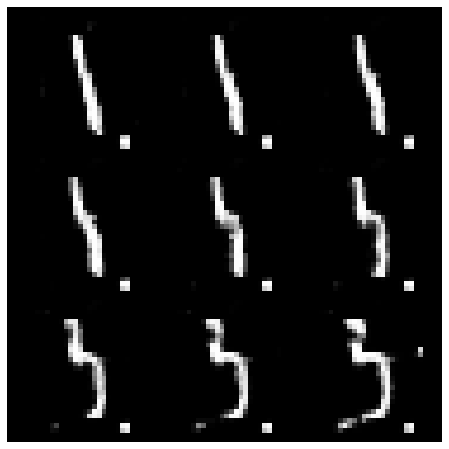

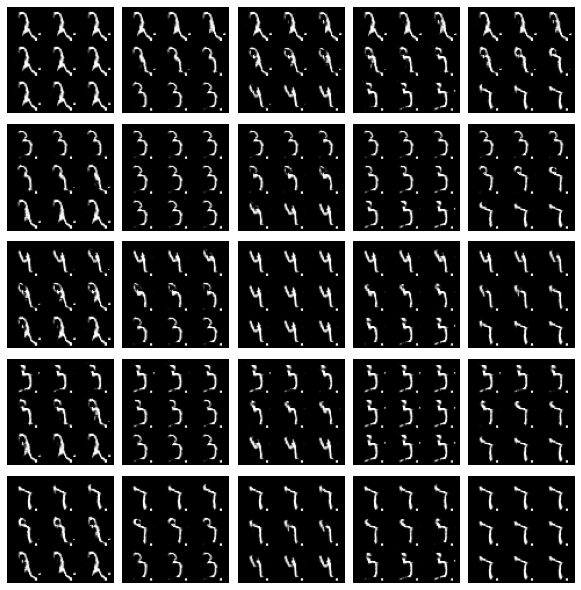

In [30]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

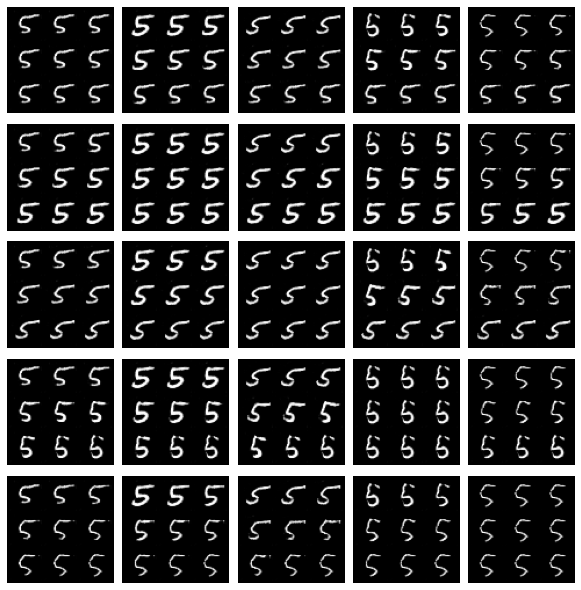

In [31]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()